In [1]:
import tensorflow as tf 
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, LeakyReLU,  Input, MaxPooling2D, UpSampling2D, Concatenate
from tensorflow.keras.models import Model
import tensorflow.keras.optimizers as optim

from sklearn.preprocessing import StandardScaler

import os 
import cv2 
import h5py
import numpy as np 
from tqdm import tqdm 
import matplotlib.pyplot as plt

In [2]:
PATH = "Dataset.hdf5"

In [3]:
files = h5py.File(PATH, "r")


In [4]:
files.keys()

<KeysViewHDF5 ['X_jets', 'm0', 'pt', 'y']>

In [5]:
dataset = np.array(files["X_jets"])

In [6]:
def standard_scale(data):
    
    # Min-Max Scaling to [0, 1]
    min_val = np.min(data)
    max_val = np.max(data)
    scaled_data = (data - min_val) / (max_val - min_val)
    
    return scaled_data

In [7]:
dataset[:, :, :, 0] = standard_scale(np.sqrt(np.sqrt(dataset[:, :, :, 0])))
dataset[:, :, :, 1] = standard_scale(dataset[:, :, :, 1])
dataset[:, :, :, 2] = standard_scale(dataset[:, :, :, 2])

In [8]:
dataset = np.pad(dataset, pad_width=((0, 0), (2, 1), (1, 2), (0, 0)), mode='constant', constant_values=0)  # All sides


In [9]:
dataset.shape

(139306, 128, 128, 3)

## Data stastical inference

In [10]:
# import numpy as np
# import heapq

# # Step 1: Flatten the array to make it a 1D array
# flattened_array = dataset[:, :, :, 2].flatten()

# # Method 1: Using heapq.nlargest() to get top 10 max values
# top_10 = heapq.nlargest(10, flattened_array)

# # Method 2: Using numpy.argsort() to get top 10 max values
# # You can use argsort to get the indices of the top 10 max values
# top_10_indices = np.argsort(flattened_array)[-10:][::-1]  # Sorting in descending order
# top_10_via_argsort = flattened_array[top_10_indices]

# print("Top 10 values using heapq:", top_10)
# print("Top 10 values using argsort:", top_10_via_argsort)


In [11]:
# top_10_indices = np.argsort(flattened_array)[-100:][::-1]  # Sorting in descending order
# top_10_via_argsort = flattened_array[top_10_indices]

# # print("Top 10 values using heapq:", top_10)
# print("Top 10 values using argsort:", top_10_via_argsort)

In [12]:
# o channel must be log and normalized, 1 channel must be divided by a certain factor and 

In [13]:
# np.max(dataset[:, :, :, 2])

In [14]:
# np.std(logdata)

## Visualization

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..13.472448].


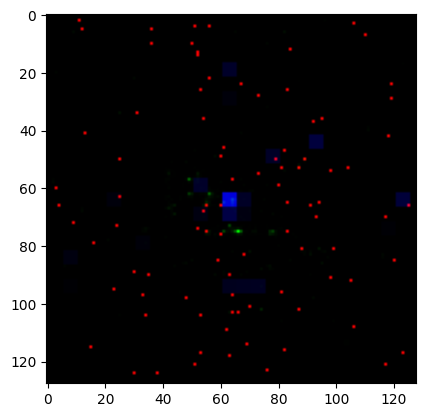

In [15]:
plt.imshow(dataset[0]*100)

In [16]:
from tensorflow.keras.regularizers import l1, l2

def Multiscale(x, filters, kernel):
    out_list = []
    for k in kernel:
        out_list.append(Conv2D(filters, k, padding="same")(x))
    return Concatenate()(out_list)

def ConvBlock(x, xresidual, filters, num,  kernel, down=True, alpha=0.03):
    xres = Conv2D(filters, 3, padding="same")(x)
    xresidual = Conv2D(filters, 1, padding="same")(xresidual)
    xres = xres + xresidual
    x = LeakyReLU(alpha)(xres)

    x_list = [xres]
    for _ in range(num):
        x_out = Multiscale(x, filters, kernel)
        x = Concatenate()([x_out] + x_list)
        x_list.append(x_out)
        x = LeakyReLU(alpha)(x)

    x = Conv2D(filters, 3, padding="same")(x)
    xres = x + xres

    x = LeakyReLU(alpha)(xres)
    # x = MaxPooling2D()(x) if down else UpSampling2D()(x)
    # xres = MaxPooling2D()(xres) if down else UpSampling2D()(xres)


    return x, xres


def MultiscaleT(x, filters, kernel):
    out_list = []
    for k in kernel:
        out_list.append(Conv2DTranspose(filters, k, padding="same")(x))
    return Concatenate()(out_list)

def ConvBlockT(x, xresidual, filters, num,  kernel, down=True, alpha=0.03):
    xres = Conv2DTranspose(filters, 3, padding="same")(x)
    xresidual = Conv2DTranspose(filters, 3, padding="same")(xresidual)
    xres = xres + xresidual
    x = LeakyReLU(alpha)(xres)

    x_list = [xres]
    for _ in range(num):
        x_out = MultiscaleT(x, filters, kernel)
        x = Concatenate()([x_out] + x_list)
        x_list.append(x_out)
        x = LeakyReLU(alpha)(x)

    x = Conv2DTranspose(filters, 3, padding="same")(x)
    xres = x + xres

    x = LeakyReLU(alpha)(xres)
    # x = MaxPooling2D()(x) if down else UpSampling2D()(x)
    # xres = MaxPooling2D()(xres) if down else UpSampling2D()(xres)

    

    return x, xres


def Autoencoder(filter = 64, depth=1, gf=2):
    inputs = Input((128, 128, 3))
    x = inputs
    xres = inputs
    x = Conv2D(64, 3, padding="same", activation="relu")(x)

    for _ in range(depth):
        x, xres = ConvBlock(x, xres, filter, 1, [1, 3, 5])
        filter = filter * gf

    for _ in range(depth):
        filter = filter // gf

        x, xres = ConvBlockT(x, xres, filter, 1, [1, 3, 5], False)
        
    x = Conv2DTranspose(64, 3, padding="same", activation="relu")(x)
    x = Conv2DTranspose(3, 1, padding="same")(x)

    return Model(inputs=inputs, outputs=x)

model = Autoencoder()
model.summary()

2025-03-19 09:14:35.093641: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2 Max
2025-03-19 09:14:35.093667: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 96.00 GB
2025-03-19 09:14:35.093672: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 36.00 GB
I0000 00:00:1742355875.093685 1031882 pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
I0000 00:00:1742355875.093702 1031882 pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 128,  │      1,792 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 128,  │     36,928 │ conv2d[0][0]      │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 128, 128,  │        256 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 128, 128,  │          0 │ conv2d_1[0][0],   │
│                     │ 64)               │            │ conv2d_2[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 128, 128,  │          0 │ add[0][0]         │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 128, 128,  │      4,160 │ leaky_re_lu[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 128, 128,  │     36,928 │ leaky_re_lu[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 128, 128,  │    102,464 │ leaky_re_lu[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 128, 128,  │          0 │ conv2d_3[0][0],   │
│ (Concatenate)       │ 192)              │            │ conv2d_4[0][0],   │
│                     │                   │            │ conv2d_5[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_1       │ (None, 128, 128,  │          0 │ concatenate[0][0… │
│ (Concatenate)       │ 256)              │            │ add[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 128, 128,  │          0 │ concatenate_1[0]… │
│ (LeakyReLU)         │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 128, 128,  │    147,520 │ leaky_re_lu_1[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_1 (Add)         │ (None, 128, 128,  │          0 │ conv2d_6[0][0],   │
│                     │ 64)               │            │ add[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 128, 128,  │          0 │ add_1[0][0]       │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose    │ (None, 128, 128,  │     36,928 │ leaky_re_lu_2[0]… │
│ (Conv2DTranspose)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 732,099 (2.79 MB)

 Trainable params: 732,099 (2.79 MB)

 Non-trainable params: 0 (0.00 B)

In [17]:
import tensorflow as tf

def sparse_weighted_loss(y_true, y_pred):
    """
    Custom loss for sparse LHC data.
    - Applies higher weights to non-zero pixels.
    - Uses channel-specific weights (adjust weights as needed).
    """
    # Mask for non-zero pixels (1 where y_true != 0)
    non_zero_mask = tf.cast(tf.math.not_equal(y_true, 0.0), tf.float32)
    
    # Weighting factors (adjust based on your dataset)
    non_zero_weight = 100.0  # Higher weight for non-zero pixels
    channel_weights = [1.0, 1.0, 10.0]  # ECAL, HCAL, tracks (adjust as needed)
    
    # Expand channel weights for broadcasting
    channel_weights = tf.constant(channel_weights, dtype=tf.float32)
    channel_weights = tf.reshape(channel_weights, (1, 1, 1, -1))  # Shape for broadcasting

    # Calculate squared error
    squared_error = tf.square(y_true - y_pred)

    # Apply channel weights
    weighted_squared_error = squared_error * channel_weights

    # Apply non-zero weights
    final_loss = tf.reduce_mean(weighted_squared_error * (1 + (non_zero_mask * (non_zero_weight - 1))))

    return final_loss

In [18]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

class VisualizePredictionCallback(tf.keras.callbacks.Callback):
    def __init__(self, train_data, val_data, num_samples=3):
        self.train_data = train_data
        self.val_data = val_data
        self.num_samples = num_samples
    
    def on_epoch_end(self, epoch, logs=None):
        fig, axes = plt.subplots(2, self.num_samples, figsize=(15, 8))

        # Visualize Training Samples
        for i in range(self.num_samples):
            idx = np.random.randint(0, len(self.train_data[0]))
            x, y_true = self.train_data[0][idx], self.train_data[1][idx]
            y_pred = self.model.predict(x[np.newaxis, ...])[0]
            
            axes[0, i].imshow(y_true*1000, cmap='gray')
            axes[0, i].set_title(f"Train Ground Truth | Epoch {epoch+1}")
            axes[1, i].imshow(y_pred*1000, cmap='gray')
            axes[1, i].set_title(f"Train Prediction")
        
        # Visualize Validation Samples
        for i in range(self.num_samples):
            idx = np.random.randint(0, len(self.val_data[0]))
            x, y_true = self.val_data[0][idx], self.val_data[1][idx]
            y_pred = self.model.predict(x[np.newaxis, ...])[0]
            
            axes[0, i].imshow(y_true*1000, cmap='gray')
            axes[0, i].set_title(f"Val Ground Truth")
            axes[1, i].imshow(y_pred*1000, cmap='gray')
            axes[1, i].set_title(f"Val Prediction")

        plt.tight_layout()
        plt.show()


In [19]:
# PSNR calculation function
def psnr(img1, img2):
  return tf.image.psnr(img1, img2, max_val=1.0)

# SSIM calculation function
def ssim(image1, image2):
    image1 = tf.image.convert_image_dtype(image1, tf.float32)
    image2 = tf.image.convert_image_dtype(image2, tf.float32)
    ssim = tf.image.ssim(image1, image2, max_val=1.0)
    return ssim

In [20]:
traindata = dataset[:5000]
validdata = dataset[5000:6000]

In [21]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning, module="matplotlib")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3667 - loss: 4.5713e-07 - mse: 1.9874e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..156.01506].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6294518..156.679].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..157.68347].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.561799..156.95361].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..130.82968].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9634806..132.84935].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..197.02306].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.7350473..188.93134].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..120.07426].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.6809013..120.34414].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..124.28481].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.720586..123.85305].


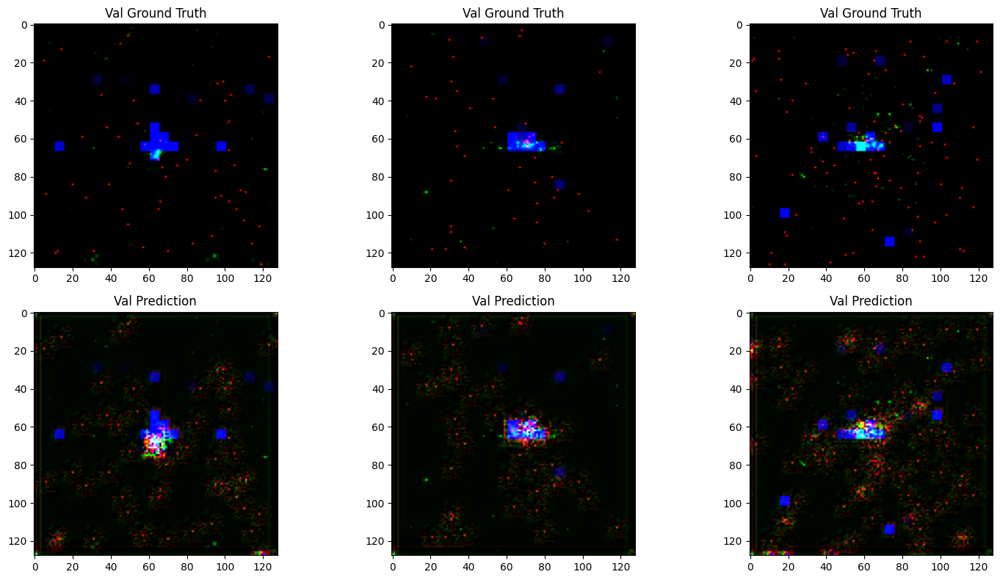

79/79 ━━━━━━━━━━━━━━━━━━━━ 82s 1s/step - accuracy: 0.3660 - loss: 4.5805e-07 - mse: 1.9892e-08 - val_accuracy: 0.2150 - val_loss: 6.1228e-07 - val_mse: 2.1649e-08
Epoch 35/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3341 - loss: 4.0789e-07 - mse: 1.8308e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..144.4646].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.8067281..147.59566].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..149.68187].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.1159..150.04976].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..168.1424].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.568889..168.50246].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..172.41255].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.442875..169.0671].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..127.40065].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5402404..128.26831].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..156.05821].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.063026..159.15034].


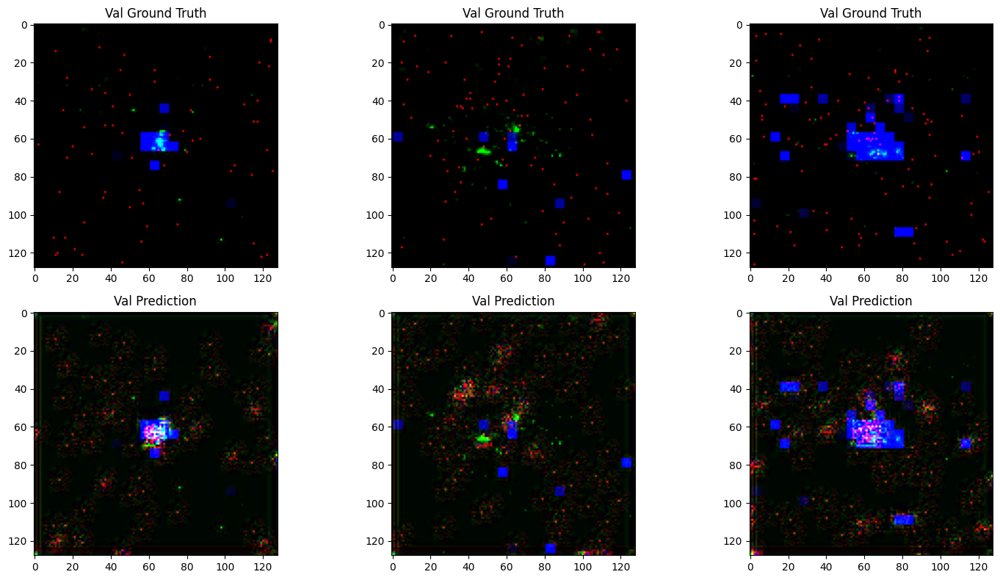

79/79 ━━━━━━━━━━━━━━━━━━━━ 79s 1s/step - accuracy: 0.3343 - loss: 4.0790e-07 - mse: 1.8310e-08 - val_accuracy: 0.1973 - val_loss: 5.2937e-07 - val_mse: 2.0055e-08
Epoch 36/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/steptep - accuracy: 0.3374 - loss: 4.6643e-07 - mse: 1.9255e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..134.41808].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3807566..132.69928].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..128.18141].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.887512..126.10701].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..142.06876].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.081031..140.28923].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..146.29884].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.5084662..145.96365].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..112.03845].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.796471..111.72865].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..125.07401].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.351352..125.71372].


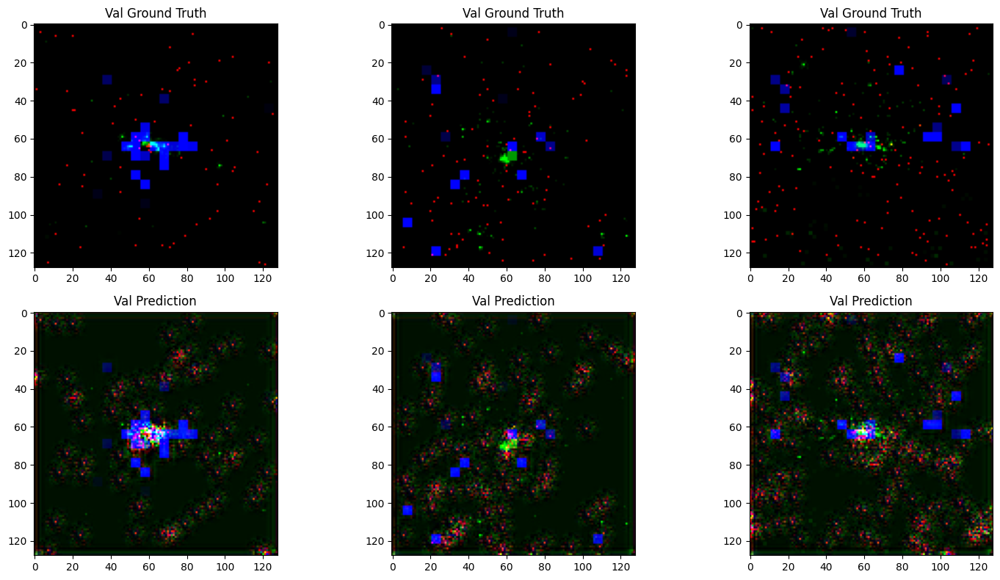

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 964ms/step - accuracy: 0.3369 - loss: 4.6916e-07 - mse: 1.9315e-08 - val_accuracy: 0.1394 - val_loss: 6.1670e-07 - val_mse: 2.4733e-08
Epoch 37/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3366 - loss: 4.1654e-07 - mse: 1.9481e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..145.85121].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.1150618..144.48335].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..142.5671].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7387712..140.7086].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..145.46097].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6324959..147.22586].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..172.35959].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6096811..170.89177].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..181.19757].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.68658..181.31566].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..138.761].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.768715..137.82399].


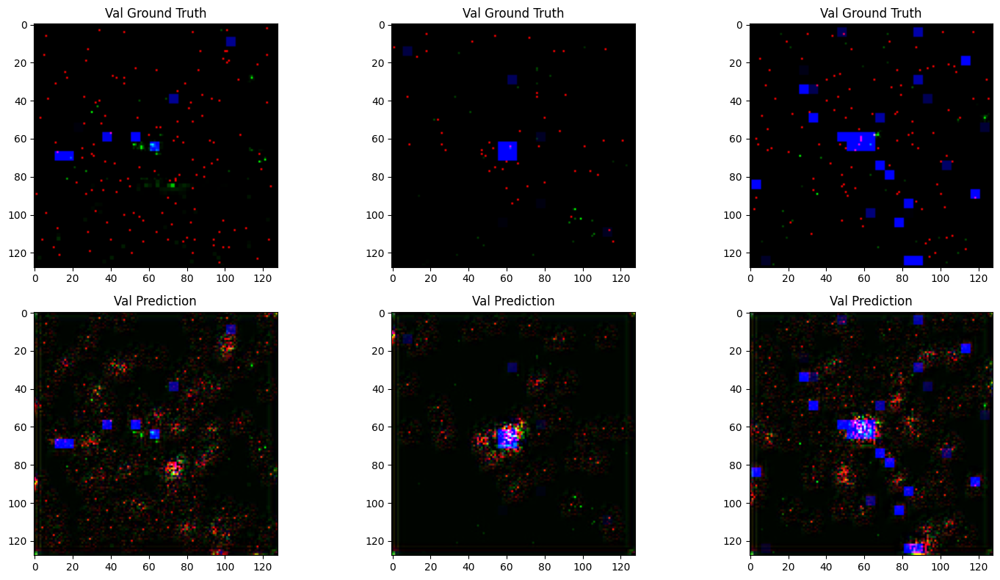

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 969ms/step - accuracy: 0.3367 - loss: 4.1631e-07 - mse: 1.9467e-08 - val_accuracy: 0.2095 - val_loss: 5.0349e-07 - val_mse: 1.8815e-08
Epoch 38/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3327 - loss: 4.9853e-07 - mse: 1.9773e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..141.05217].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.5104046..141.79515].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..172.47195].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.5425735..169.82945].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..132.11388].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.80008..131.99522].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..93.4317].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3224828..93.19837].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..188.37444].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.2086782..189.49796].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..132.23045].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.4598932..129.94669].


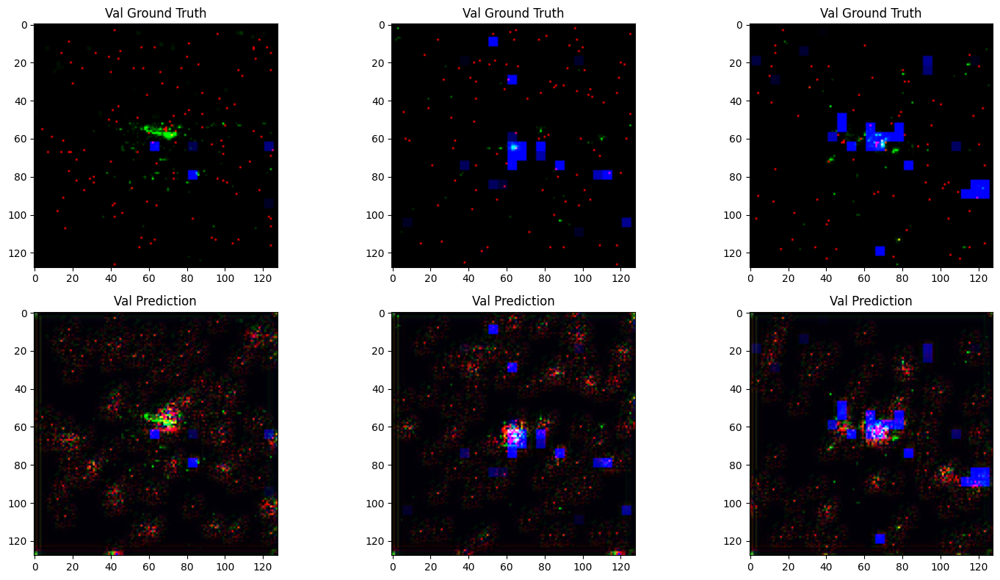

79/79 ━━━━━━━━━━━━━━━━━━━━ 74s 941ms/step - accuracy: 0.3323 - loss: 4.9847e-07 - mse: 1.9771e-08 - val_accuracy: 0.2614 - val_loss: 5.0129e-07 - val_mse: 1.8668e-08
Epoch 39/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.2899 - loss: 4.5515e-07 - mse: 1.7939e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..129.6577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.2092078..127.29293].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..123.19184].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6666727..122.931915].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..138.95772].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.1951818..138.57803].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..126.2523].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7175694..124.24167].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..175.66988].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.371733..172.68219].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..141.83298].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.1916335..143.93932].


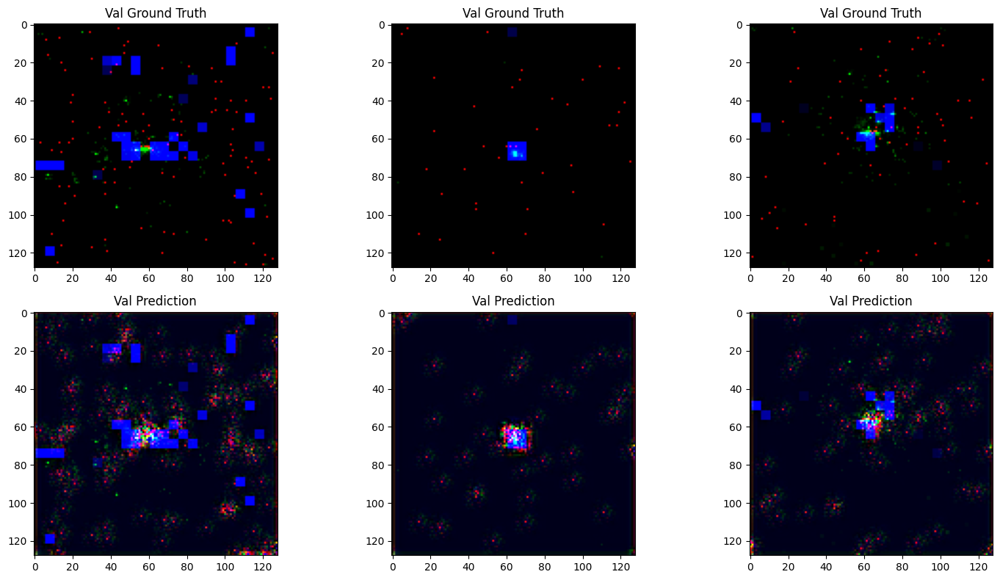

79/79 ━━━━━━━━━━━━━━━━━━━━ 74s 940ms/step - accuracy: 0.2899 - loss: 4.5833e-07 - mse: 1.8013e-08 - val_accuracy: 0.0946 - val_loss: 6.9205e-07 - val_mse: 2.9804e-08
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/steptep - accuracy: 0.3660 - loss: 3.9753e-07 - mse: 1.9014e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..126.141045].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.4186287..123.03179].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..106.28611].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3501902..110.67316].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..139.07466].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.5346515..140.40543].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..152.5862].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7865644..154.08403].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..134.38446].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.4855385..134.5527].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..103.04412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3252046..103.64659].


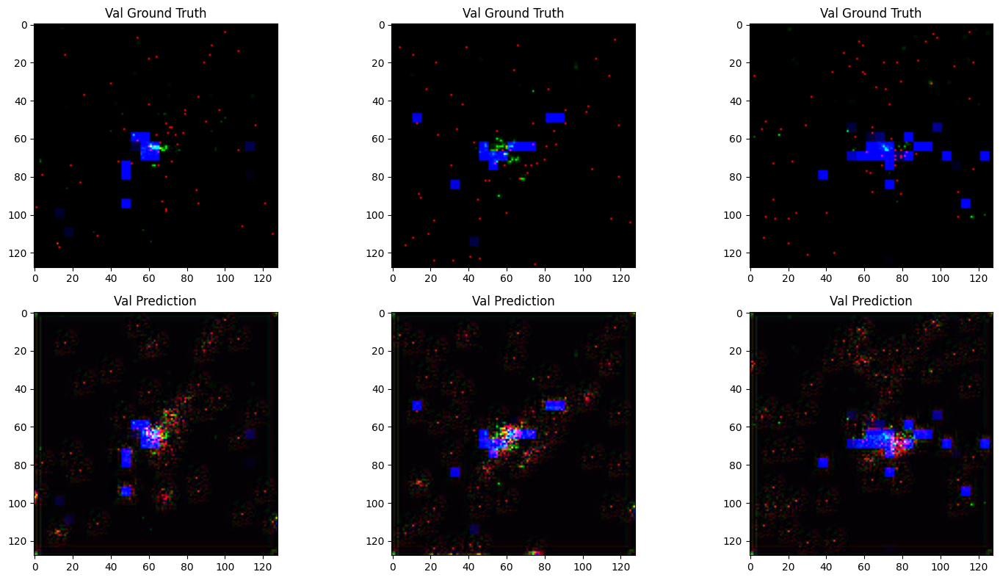

79/79 ━━━━━━━━━━━━━━━━━━━━ 75s 955ms/step - accuracy: 0.3660 - loss: 3.9719e-07 - mse: 1.8991e-08 - val_accuracy: 0.3307 - val_loss: 4.7329e-07 - val_mse: 1.7754e-08
Epoch 41/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3385 - loss: 3.7262e-07 - mse: 1.5841e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..134.89151].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.284864..134.79688].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..130.01833].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.0910554..131.5723].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..155.65895].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.778108..155.35448].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..104.02939].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9448286..105.358215].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..141.1519].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.2617483..142.69832].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..122.213005].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1599839..121.793884].


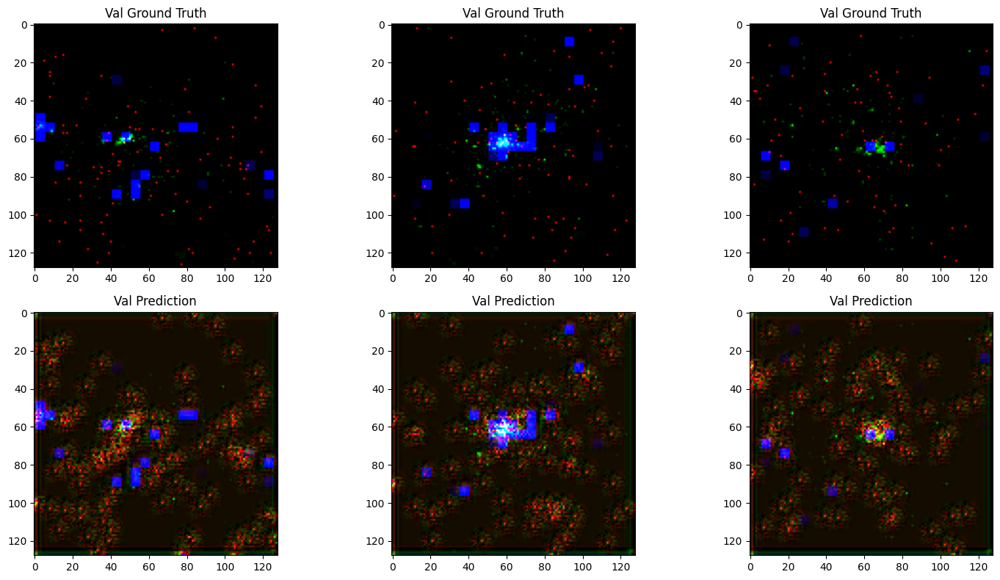

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 974ms/step - accuracy: 0.3379 - loss: 3.7472e-07 - mse: 1.5891e-08 - val_accuracy: 0.7501 - val_loss: 7.7902e-07 - val_mse: 2.8590e-08
Epoch 42/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3615 - loss: 4.0168e-07 - mse: 1.8177e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..103.44219].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.048869..105.34362].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..136.68759].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9704243..136.1087].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..133.88702].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.4463952..133.53462].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..133.19086].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.1018116..133.7082].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..139.41202].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.6005344..139.62206].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..123.26808].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0613554..122.44811].


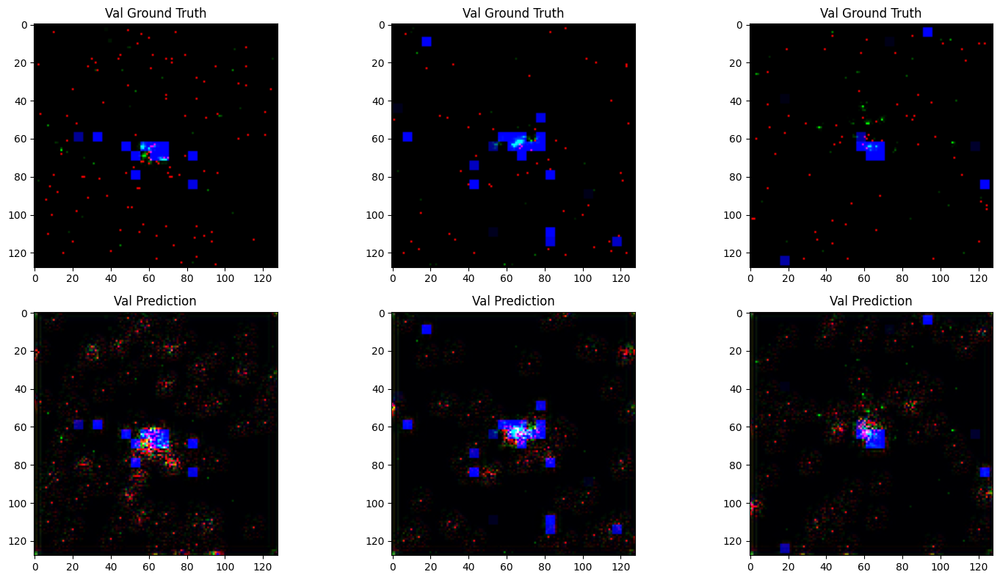

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 963ms/step - accuracy: 0.3615 - loss: 4.0111e-07 - mse: 1.8153e-08 - val_accuracy: 0.1919 - val_loss: 4.5617e-07 - val_mse: 1.6729e-08
Epoch 43/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.2862 - loss: 3.9433e-07 - mse: 1.5736e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..133.51219].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.8769276..132.75998].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..124.16391].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3188434..121.96284].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..139.80267].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.070871..139.53474].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..125.03838].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.402854..123.63023].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..129.3122].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.445998..128.57787].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..123.88439].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8309262..124.46241].


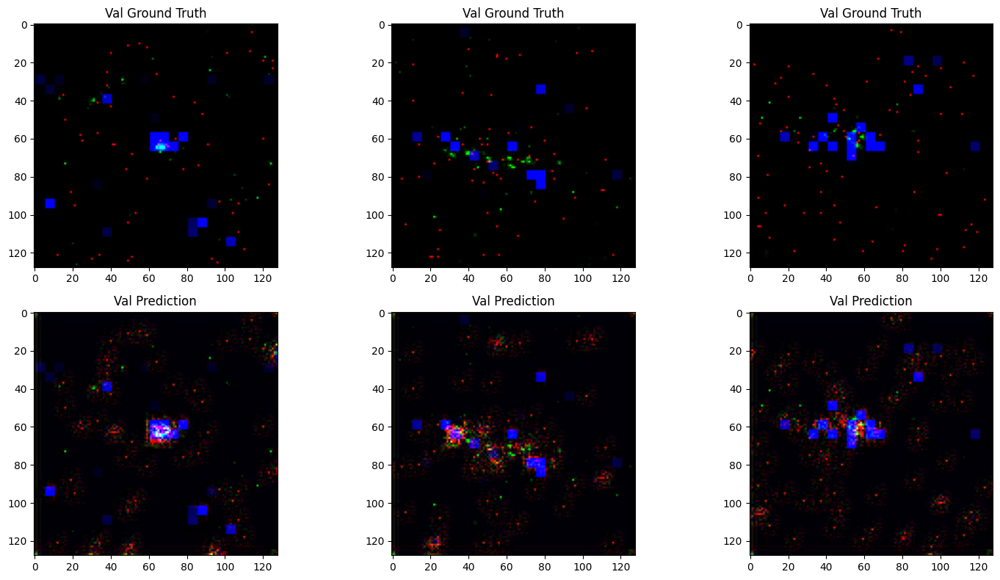

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 960ms/step - accuracy: 0.2862 - loss: 3.9490e-07 - mse: 1.5751e-08 - val_accuracy: 0.2151 - val_loss: 4.4910e-07 - val_mse: 1.6650e-08
Epoch 44/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.2638 - loss: 4.4963e-07 - mse: 1.7386e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..129.2234].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.2334323..129.03871].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..99.78876].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.136206..99.958626].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..112.608505].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.635351..111.16873].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..175.59412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.4783745..173.42192].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..149.32758].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.8626323..149.35995].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..111.632256].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9830153..109.94287].


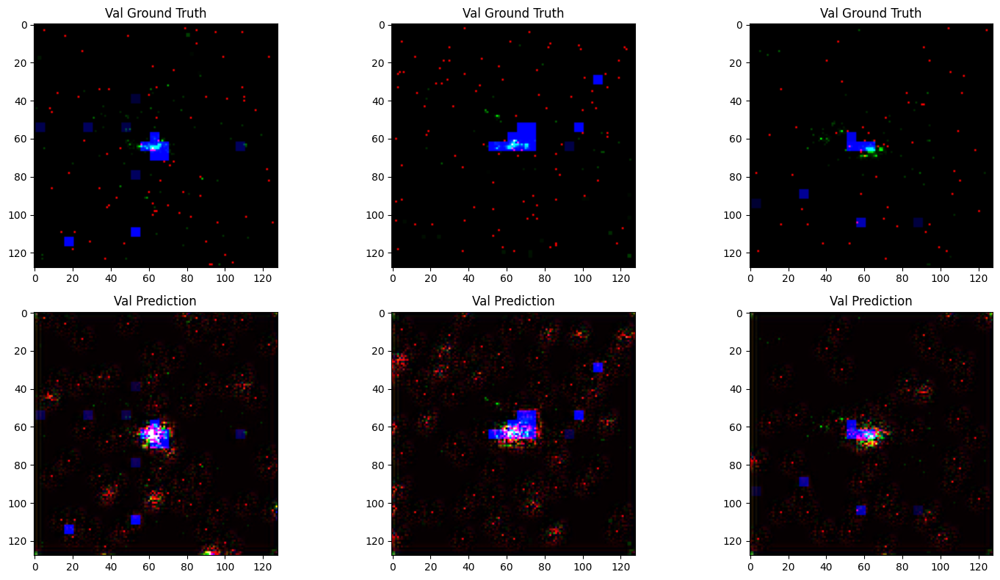

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 964ms/step - accuracy: 0.2640 - loss: 4.4952e-07 - mse: 1.7382e-08 - val_accuracy: 0.6888 - val_loss: 4.2734e-07 - val_mse: 1.6686e-08
Epoch 45/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/steptep - accuracy: 0.3213 - loss: 7.9686e-07 - mse: 2.5955e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..108.491844].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5719817..109.29333].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..101.31308].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.0785985..101.031944].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..158.05757].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.471938..156.61478].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..170.43352].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.9373553..170.82794].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..133.05666].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8670174..132.50388].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..134.1391].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.9670217..133.86034].


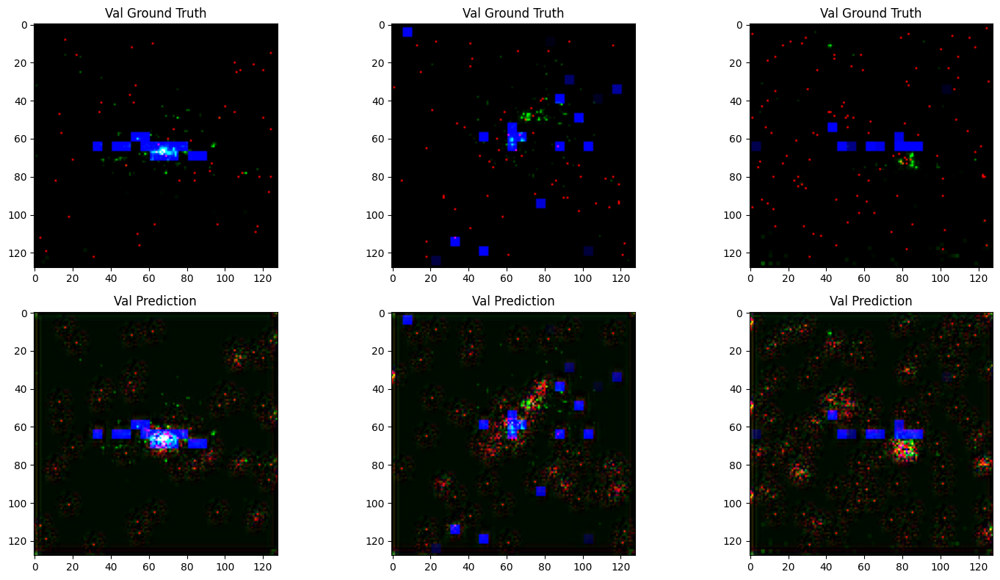

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 967ms/step - accuracy: 0.3213 - loss: 7.9485e-07 - mse: 2.5914e-08 - val_accuracy: 0.1960 - val_loss: 4.2385e-07 - val_mse: 1.6474e-08
Epoch 46/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/steptep - accuracy: 0.3909 - loss: 3.2452e-07 - mse: 1.5422e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..116.05792].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8246512..115.94237].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..104.056274].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.8374865..103.79141].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..106.4846].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.780148..109.49642].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..105.02169].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.121034..103.126335].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..147.28474].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.195642..147.02695].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..137.99425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3925874..140.22131].


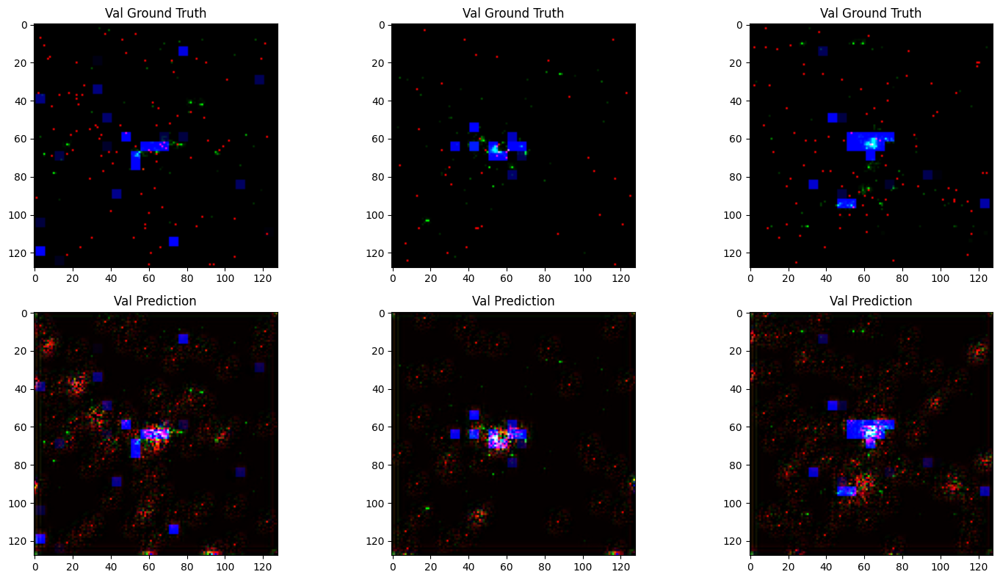

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 972ms/step - accuracy: 0.3904 - loss: 3.2443e-07 - mse: 1.5408e-08 - val_accuracy: 0.7102 - val_loss: 4.2787e-07 - val_mse: 1.5566e-08
Epoch 47/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.2804 - loss: 8.1388e-07 - mse: 2.5693e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..123.7802].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.0076575..126.874146].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..111.80582].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7238097..112.0813].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..128.70645].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5482965..127.62894].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..145.80757].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.8810003..146.21703].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..127.119064].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.935975..127.4721].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..102.967926].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3830743..102.059845].


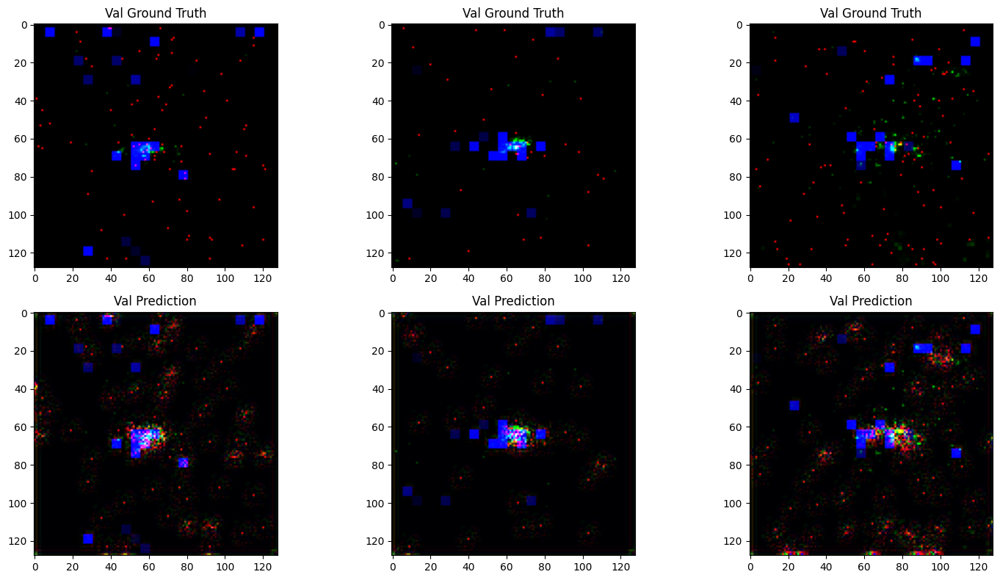

79/79 ━━━━━━━━━━━━━━━━━━━━ 80s 1s/step - accuracy: 0.2806 - loss: 8.1196e-07 - mse: 2.5660e-08 - val_accuracy: 0.1918 - val_loss: 4.1069e-07 - val_mse: 1.5434e-08
Epoch 48/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/steptep - accuracy: 0.3577 - loss: 2.8972e-07 - mse: 1.3162e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..127.295525].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4212453..126.03113].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..109.369026].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.1047163..109.8335].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..176.27313].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7004669..175.95515].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..142.37982].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5920835..142.06947].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..122.10941].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.5125697..123.923164].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..129.44295].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.8761127..130.13118].


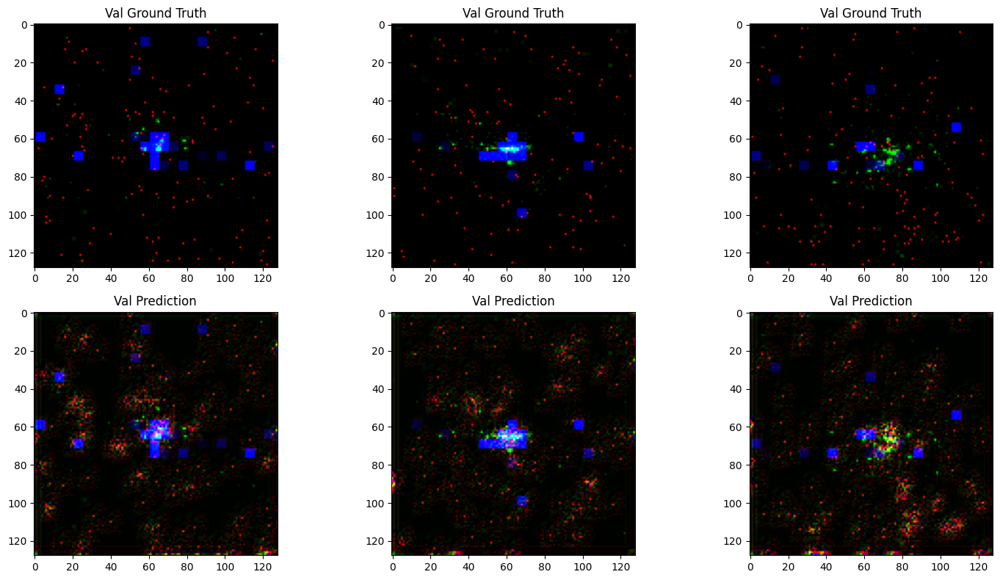

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 969ms/step - accuracy: 0.3578 - loss: 2.8967e-07 - mse: 1.3162e-08 - val_accuracy: 0.3208 - val_loss: 3.9308e-07 - val_mse: 1.4545e-08
Epoch 49/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/steptep - accuracy: 0.2842 - loss: 3.8920e-07 - mse: 1.4830e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..121.67896].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.089849..121.439545].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..132.70753].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9397855..134.33261].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..122.41469].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0738354..122.79474].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..85.78901].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.1185656..85.822815].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..139.27267].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7559204..138.78929].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..127.205345].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7135988..126.96673].


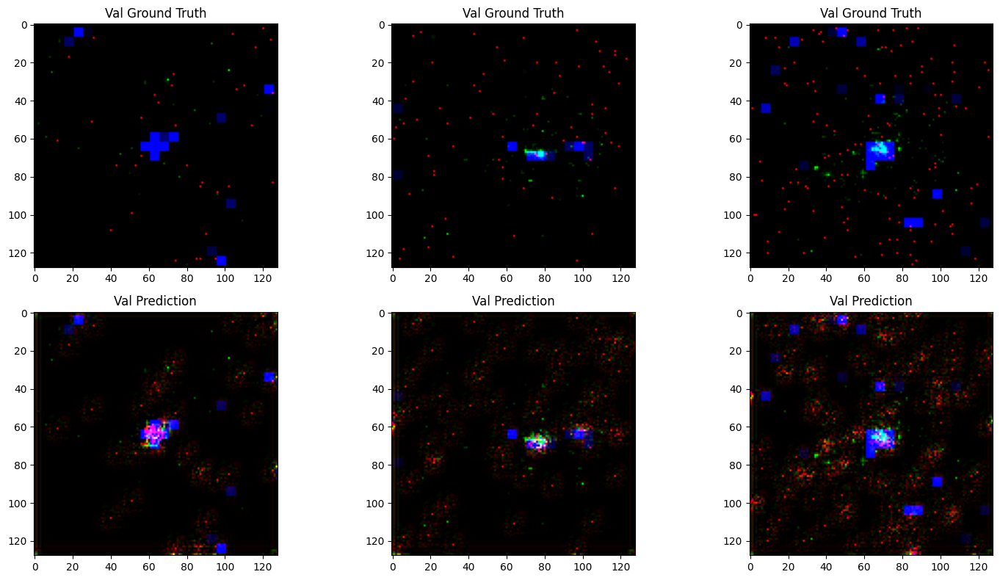

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 980ms/step - accuracy: 0.2841 - loss: 3.8940e-07 - mse: 1.4836e-08 - val_accuracy: 0.7038 - val_loss: 4.2342e-07 - val_mse: 1.4705e-08
Epoch 50/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.3291 - loss: 2.8970e-07 - mse: 1.2628e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..124.20068].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.535099..125.24827].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..101.098724].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7442285..101.317696].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..132.8701].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.167746..133.20598].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..143.4314].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.1911507..142.84045].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..157.84578].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.36112..159.12149].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..117.646996].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5306873..117.445175].


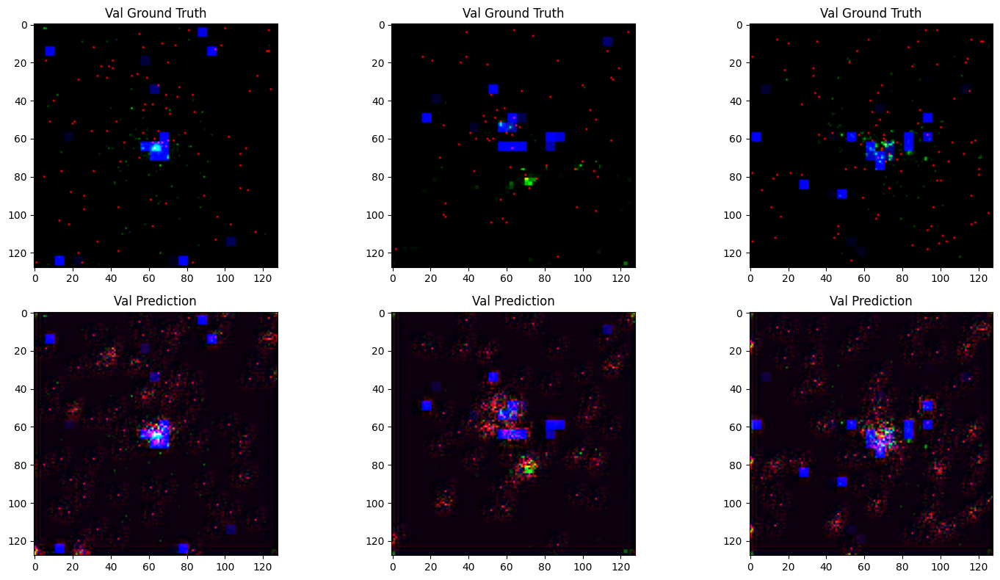

79/79 ━━━━━━━━━━━━━━━━━━━━ 86s 1s/step - accuracy: 0.3287 - loss: 2.9018e-07 - mse: 1.2637e-08 - val_accuracy: 0.3432 - val_loss: 4.6293e-07 - val_mse: 1.6500e-08
Epoch 51/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/steptep - accuracy: 0.3163 - loss: 3.1899e-07 - mse: 1.3347e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..128.33295].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6868298..128.09962].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..140.24857].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7919152..139.56067].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..129.70842].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.676728..130.33281].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..171.33609].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.0935707..172.20511].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..150.5115].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.2044818..151.10158].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..111.090416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7009535..111.91035].


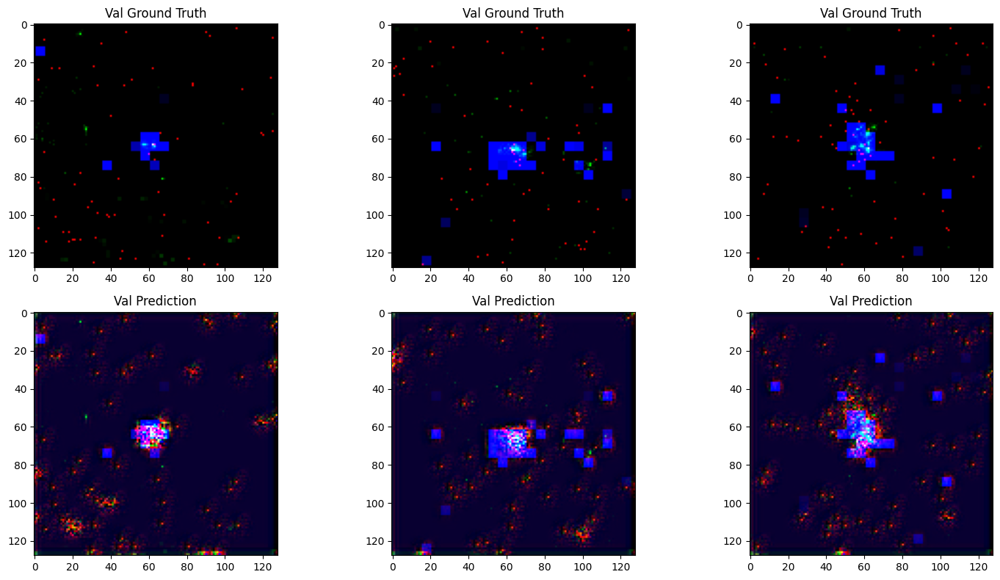

79/79 ━━━━━━━━━━━━━━━━━━━━ 78s 989ms/step - accuracy: 0.3162 - loss: 3.2041e-07 - mse: 1.3372e-08 - val_accuracy: 0.1141 - val_loss: 6.4621e-07 - val_mse: 2.9502e-08
Epoch 52/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.2932 - loss: 9.0548e-07 - mse: 3.1718e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..107.162605].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.4935315..109.04157].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..135.03069].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5208633..135.8022].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..169.88556].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.563852..172.24121].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..140.89139].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.8184547..141.68465].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..117.583435].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6032043..119.07848].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..137.43462].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.811191..135.85379].


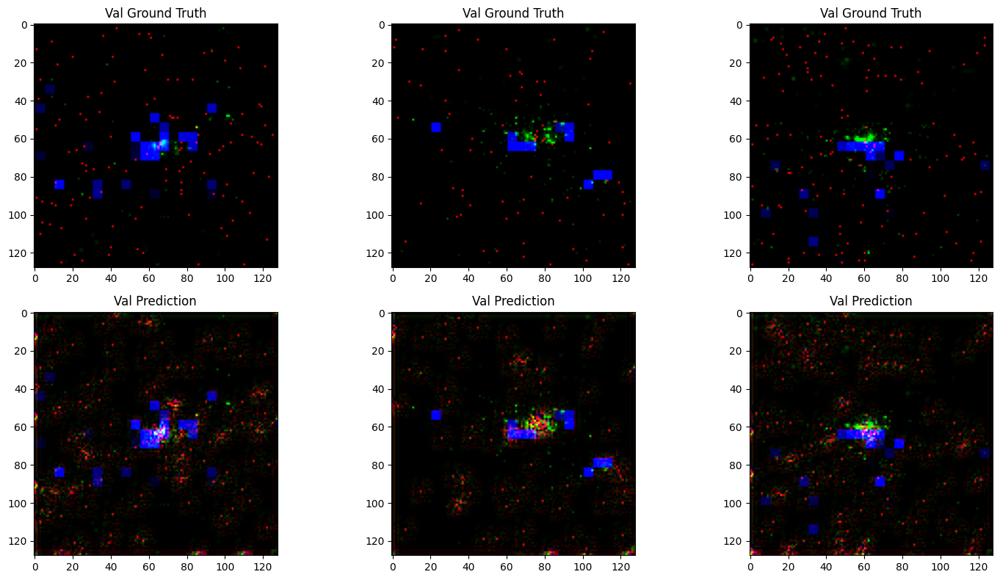

79/79 ━━━━━━━━━━━━━━━━━━━━ 80s 1s/step - accuracy: 0.2940 - loss: 9.0046e-07 - mse: 3.1593e-08 - val_accuracy: 0.2939 - val_loss: 3.7241e-07 - val_mse: 1.3942e-08
Epoch 53/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - accuracy: 0.3835 - loss: 3.5775e-07 - mse: 1.4337e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..105.59783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6358263..105.62462].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..111.13154].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.2793756..111.824974].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..134.0289].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.567104..133.97609].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..147.24461].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.5424733..146.55475].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..121.89751].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.715342..123.67739].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..126.47562].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.814667..126.41166].


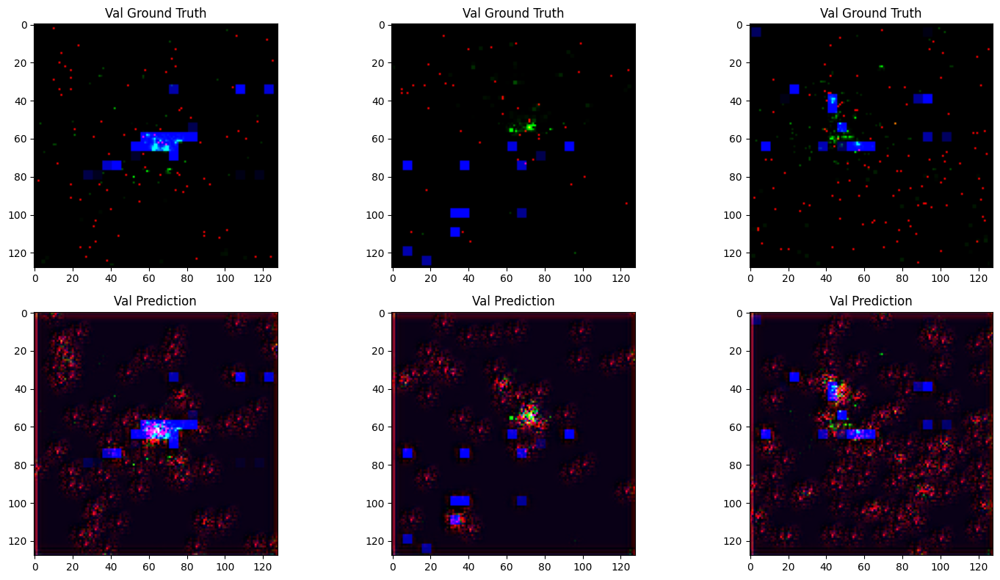

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 971ms/step - accuracy: 0.3831 - loss: 3.6172e-07 - mse: 1.4436e-08 - val_accuracy: 0.3020 - val_loss: 4.8708e-07 - val_mse: 3.0141e-08
Epoch 54/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3913 - loss: 4.1292e-07 - mse: 2.1522e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..132.65244].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.4492004..130.72482].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..105.725655].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8667318..99.8009].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..124.663666].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.1302373..124.5745].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..151.31204].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.9505758..150.50583].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..146.49577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5152187..147.42326].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..95.782135].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.625905..95.9495].


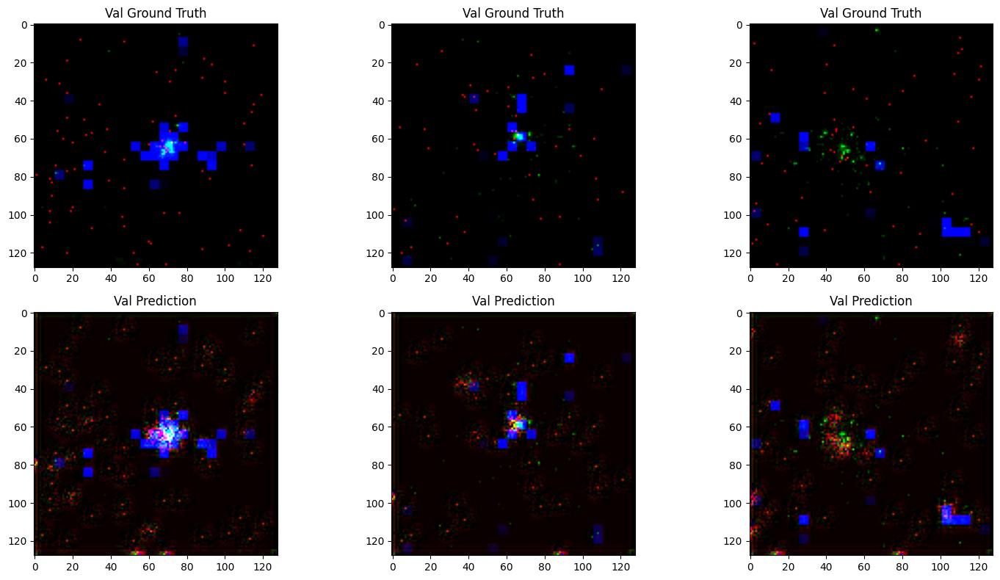

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 981ms/step - accuracy: 0.3911 - loss: 4.1184e-07 - mse: 2.1459e-08 - val_accuracy: 0.7683 - val_loss: 3.6065e-07 - val_mse: 1.4290e-08
Epoch 55/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.4075 - loss: 2.4483e-07 - mse: 1.1900e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..122.36603].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.9164796..123.37353].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..136.0743].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.1440265..135.17581].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..124.74267].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.7596502..124.09167].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..104.43787].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1707342..105.010735].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..148.10153].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.754982..146.93005].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..147.58508].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.1488776..145.35493].


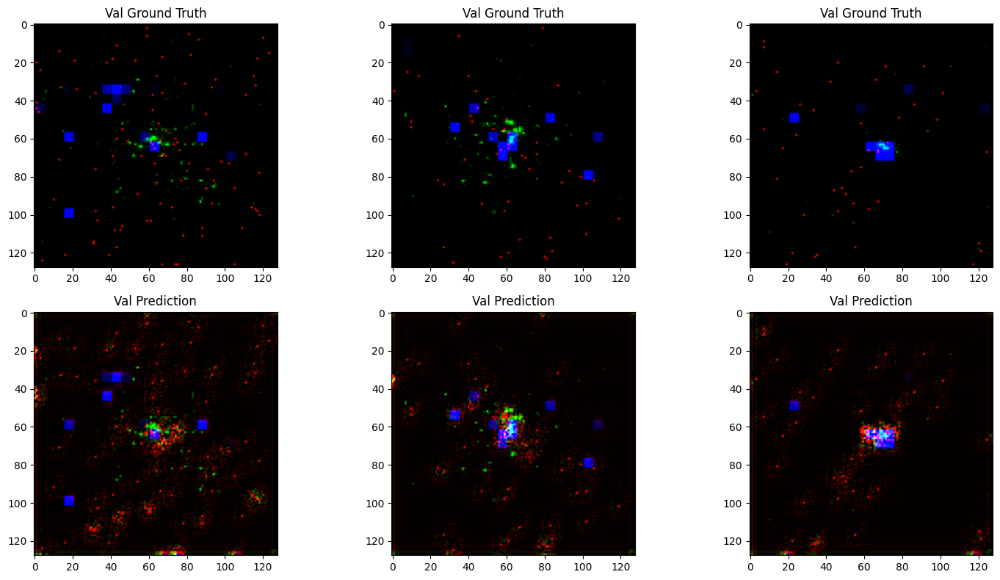

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 966ms/step - accuracy: 0.4072 - loss: 2.4497e-07 - mse: 1.1900e-08 - val_accuracy: 0.8733 - val_loss: 1.7547e-06 - val_mse: 3.1605e-08
Epoch 56/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - accuracy: 0.3801 - loss: 4.6148e-07 - mse: 1.6828e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..130.43665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.6347265..129.66199].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..161.58688].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.6410527..162.3751].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..121.24226].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.845785..119.59182].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..119.828896].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.5200877..119.11873].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..110.90499].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.707698..113.89288].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..141.64597].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5830925..140.97073].


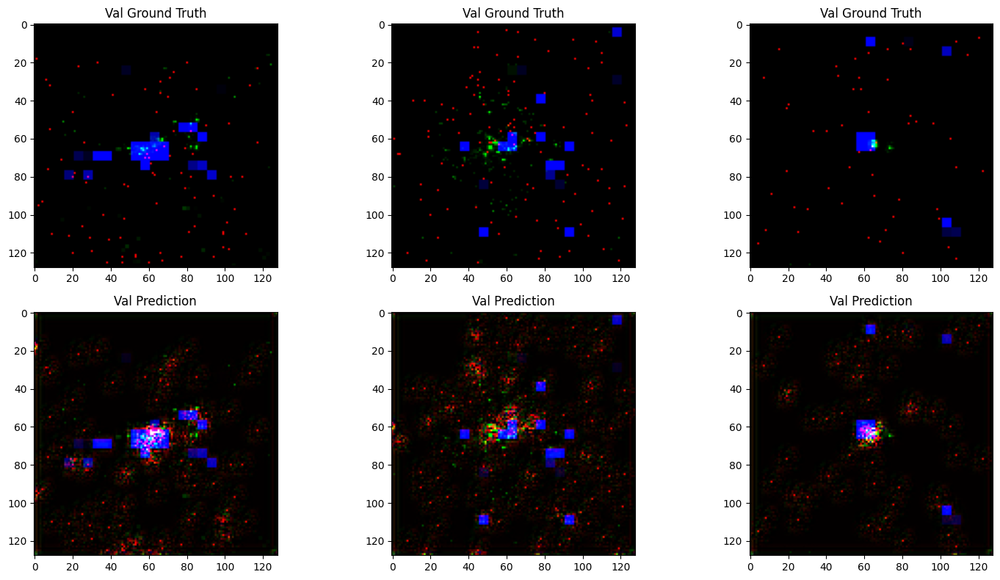

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 962ms/step - accuracy: 0.3803 - loss: 4.5963e-07 - mse: 1.6788e-08 - val_accuracy: 0.6783 - val_loss: 4.1822e-07 - val_mse: 1.3242e-08
Epoch 57/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/steptep - accuracy: 0.3070 - loss: 2.9801e-07 - mse: 1.1884e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..145.42992].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.509814..148.43208].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..141.58952].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7366636..142.88124].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..108.257324].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7528652..109.63229].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..136.64719].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5254476..138.99986].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..99.14307].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3844512..99.42979].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..143.4314].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6446915..142.9812].


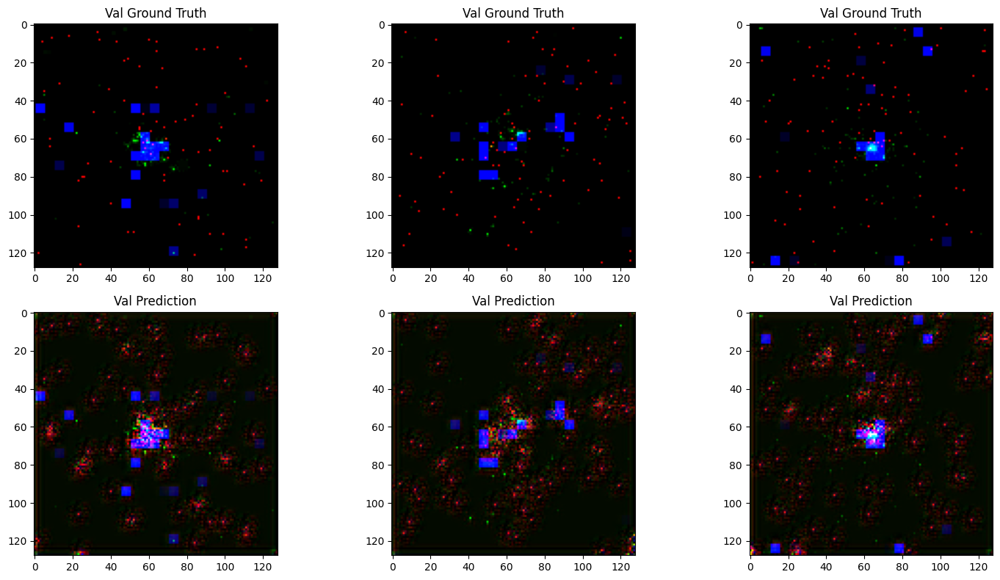

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 960ms/step - accuracy: 0.3070 - loss: 2.9841e-07 - mse: 1.1892e-08 - val_accuracy: 0.3233 - val_loss: 3.7373e-07 - val_mse: 1.4294e-08
Epoch 58/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3187 - loss: 3.6368e-07 - mse: 1.3957e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..119.6231].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5479975..119.68486].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..144.95882].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.1090384..146.454].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..142.10419].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.4562905..140.97757].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..145.44739].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.0394835..146.17294].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..121.89751].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.895595..123.54329].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..149.13084].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.4092894..148.46474].


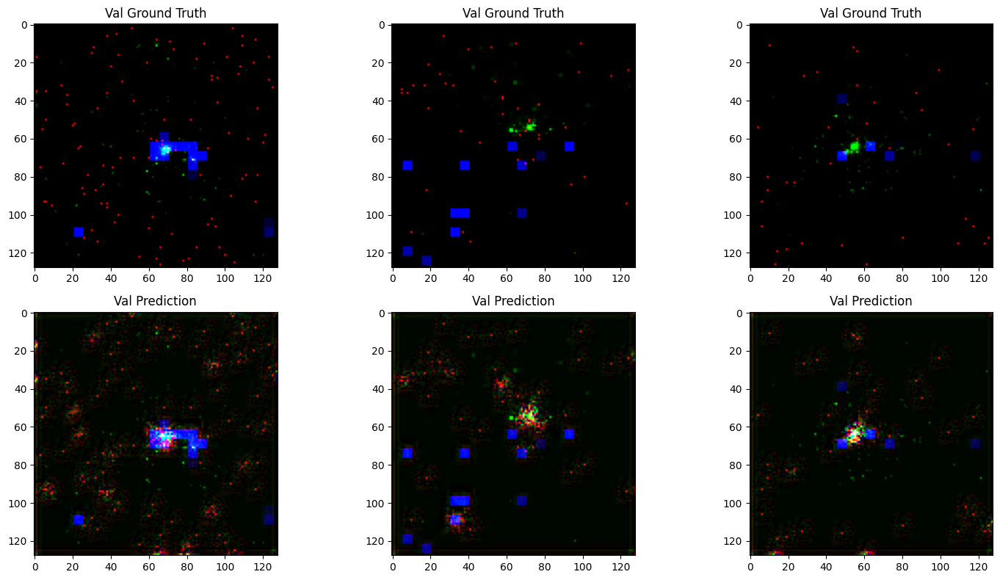

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 968ms/step - accuracy: 0.3196 - loss: 3.6363e-07 - mse: 1.3961e-08 - val_accuracy: 0.2530 - val_loss: 3.2515e-07 - val_mse: 1.2512e-08
Epoch 59/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3582 - loss: 2.6742e-07 - mse: 1.1537e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..141.04327].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7337606..140.6091].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..147.8578].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.393957..147.23752].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..108.61419].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7866378..109.03462].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..177.20778].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9248875..178.7917].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..117.58803].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9101733..117.06023].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..121.01009].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0907278..121.11761].


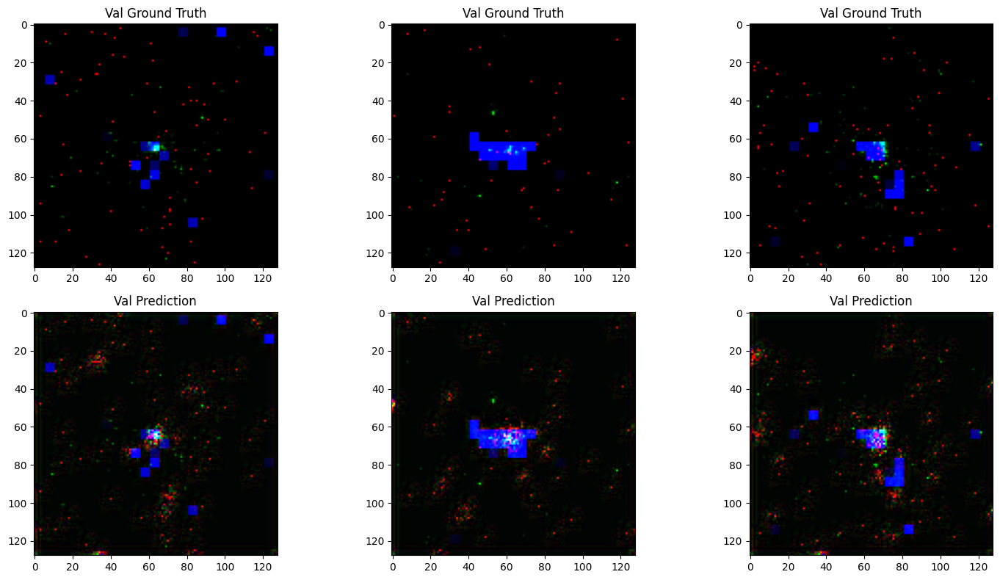

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 967ms/step - accuracy: 0.3581 - loss: 2.6728e-07 - mse: 1.1532e-08 - val_accuracy: 0.2090 - val_loss: 3.0910e-07 - val_mse: 1.1838e-08
Epoch 60/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3107 - loss: 3.2121e-07 - mse: 1.1953e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..123.05783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3507063..122.64567].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..113.24239].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4646931..113.91349].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..130.6333].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.097226..132.4698].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..126.04463].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.4444227..126.02559].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..150.27399].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.57498..151.3268].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..146.33441].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.5267324..143.05428].


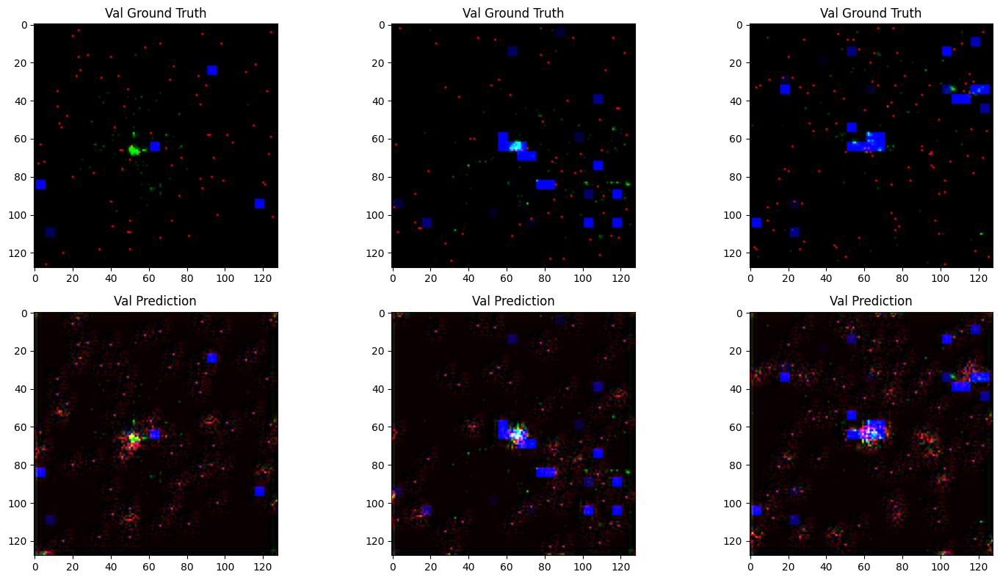

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 967ms/step - accuracy: 0.3105 - loss: 3.2214e-07 - mse: 1.1975e-08 - val_accuracy: 0.7339 - val_loss: 3.4581e-07 - val_mse: 1.2786e-08
Epoch 61/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3647 - loss: 8.8952e-07 - mse: 2.9874e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..147.15912].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.9582946..148.6542].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..109.65265].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8326684..110.09911].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..130.28392].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3017378..129.6155].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..109.82186].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1390603..110.22374].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..171.81737].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.8788853..170.53738].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..99.02447].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.303653..99.99286].


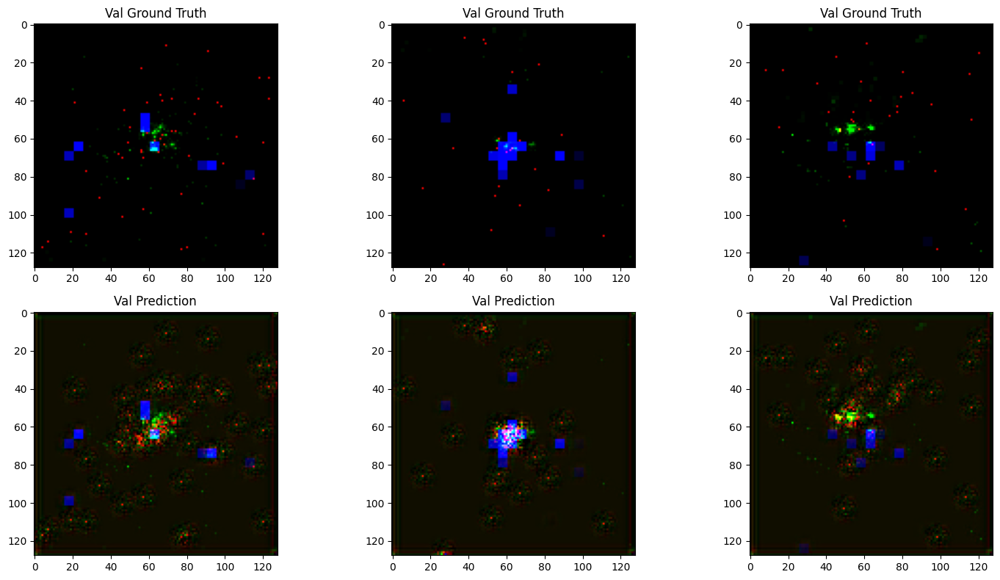

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 969ms/step - accuracy: 0.3646 - loss: 8.8636e-07 - mse: 2.9829e-08 - val_accuracy: 0.6321 - val_loss: 9.5055e-07 - val_mse: 2.1093e-08
Epoch 62/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - accuracy: 0.3974 - loss: 3.7795e-07 - mse: 1.4129e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..164.20337].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7451942..163.36906].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..146.1834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.0108182..148.07224].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..125.479576].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.2508767..125.86717].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..239.25375].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.5134594..240.07335].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..131.69437].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.627973..132.91496].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..154.19797].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.4339747..156.12872].


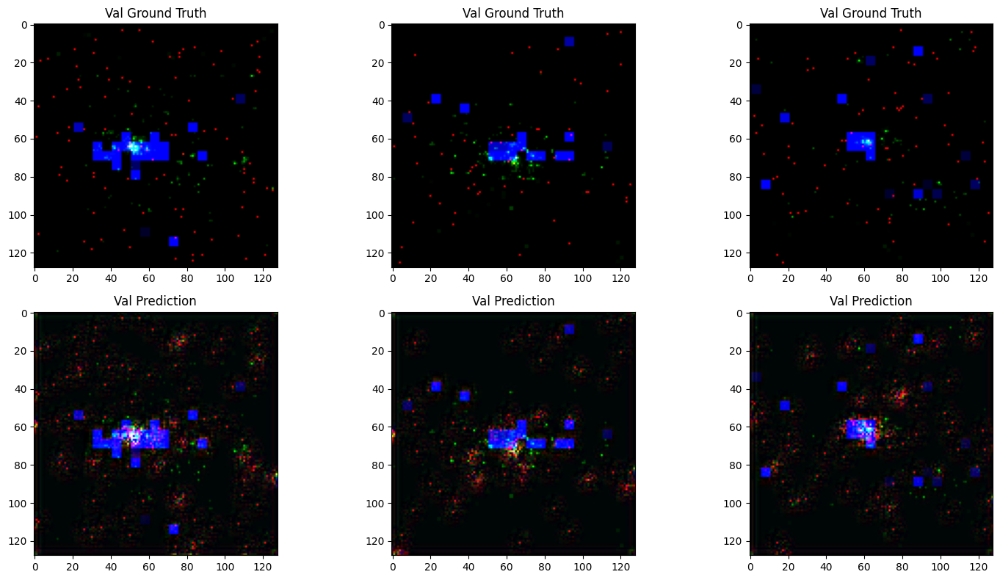

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 973ms/step - accuracy: 0.3971 - loss: 3.7674e-07 - mse: 1.4101e-08 - val_accuracy: 0.2003 - val_loss: 3.0345e-07 - val_mse: 1.1764e-08
Epoch 63/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3386 - loss: 2.4371e-07 - mse: 1.0554e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..124.93495].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0624485..125.10386].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..137.88593].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.2197711..139.7143].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..154.14325].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3885958..153.91862].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..165.80222].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3625793..163.89084].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..118.756134].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.515114..118.22519].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..145.32787].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3877807..142.61699].


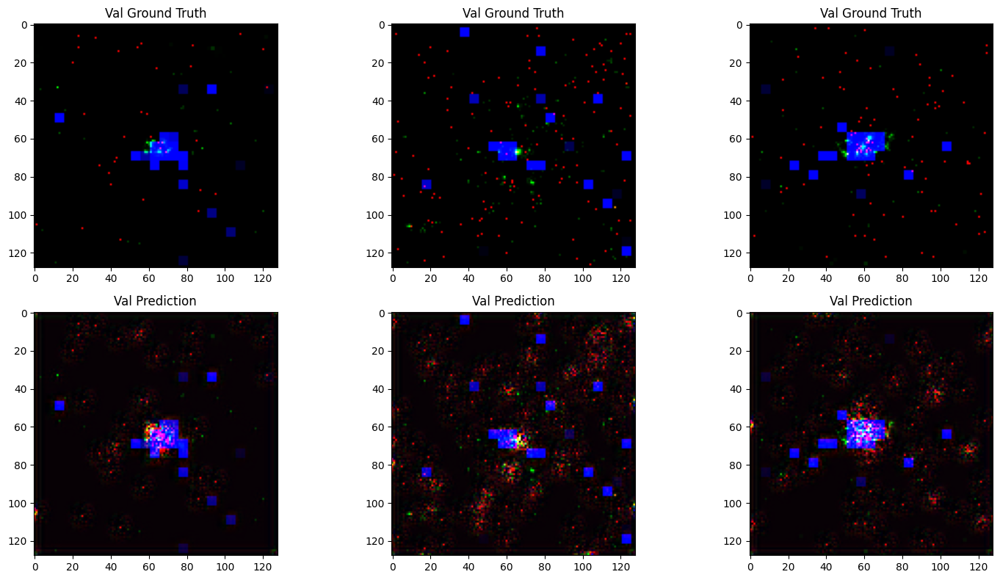

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 972ms/step - accuracy: 0.3387 - loss: 2.4376e-07 - mse: 1.0552e-08 - val_accuracy: 0.6703 - val_loss: 2.9461e-07 - val_mse: 1.1581e-08
Epoch 64/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3905 - loss: 2.4140e-07 - mse: 1.0130e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..136.90297].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.9906385..137.85478].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..114.92038].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.718586..114.142494].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..168.95892].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.841346..168.39601].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..133.16661].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1835394..134.27821].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..125.13614].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5702205..124.553085].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..141.83298].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.4767075..142.9035].


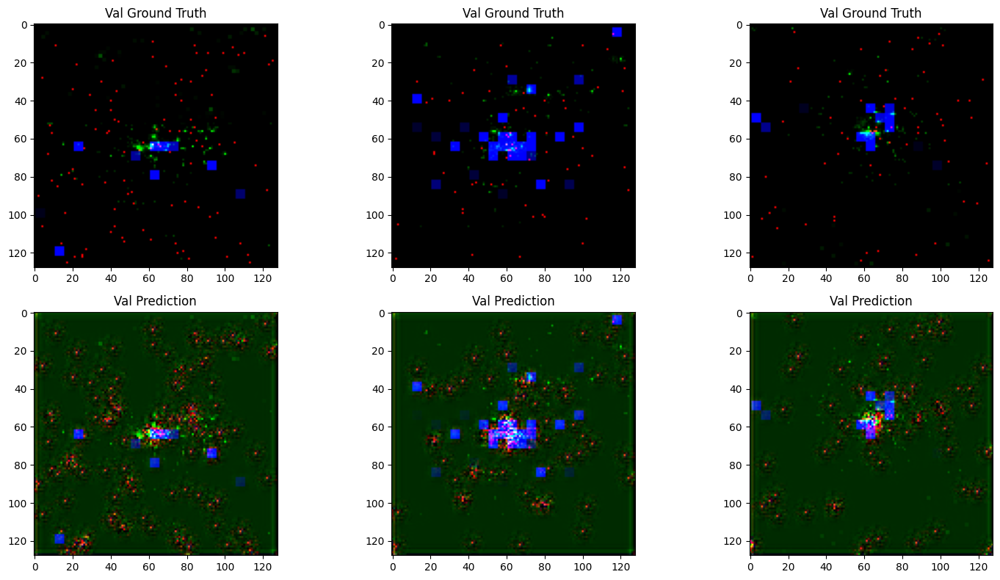

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 972ms/step - accuracy: 0.3899 - loss: 2.4324e-07 - mse: 1.0166e-08 - val_accuracy: 0.0737 - val_loss: 8.6652e-07 - val_mse: 2.6861e-08
Epoch 65/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3822 - loss: 7.8683e-07 - mse: 3.4995e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..122.41469].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7390563..120.94578].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..108.27908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.300088..108.839676].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..189.62708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.5006375..183.2452].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..171.61497].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5212517..173.01012].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..102.56868].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.62506..102.32099].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..155.59674].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.3369784..157.00822].


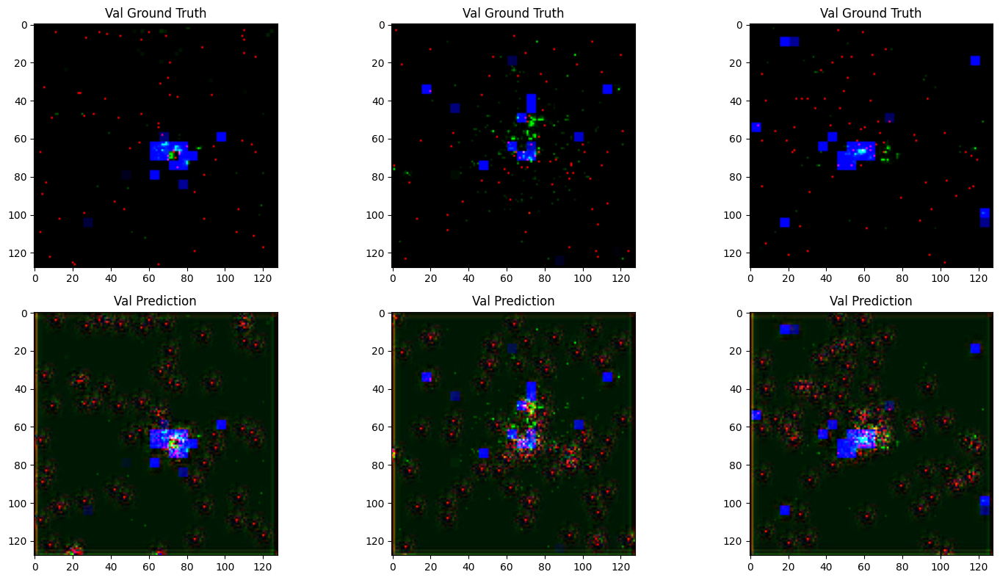

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 970ms/step - accuracy: 0.3820 - loss: 7.8712e-07 - mse: 3.4950e-08 - val_accuracy: 0.1659 - val_loss: 3.9898e-07 - val_mse: 1.8016e-08
Epoch 66/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - accuracy: 0.2815 - loss: 3.3297e-07 - mse: 1.3799e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..132.44124].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9603658..131.82854].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..139.63536].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.0098453..140.91277].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..183.78973].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.5060685..181.96124].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..152.76486].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.2038965..151.08212].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..123.5112].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9493208..123.75857].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..154.61696].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6875267..153.46732].


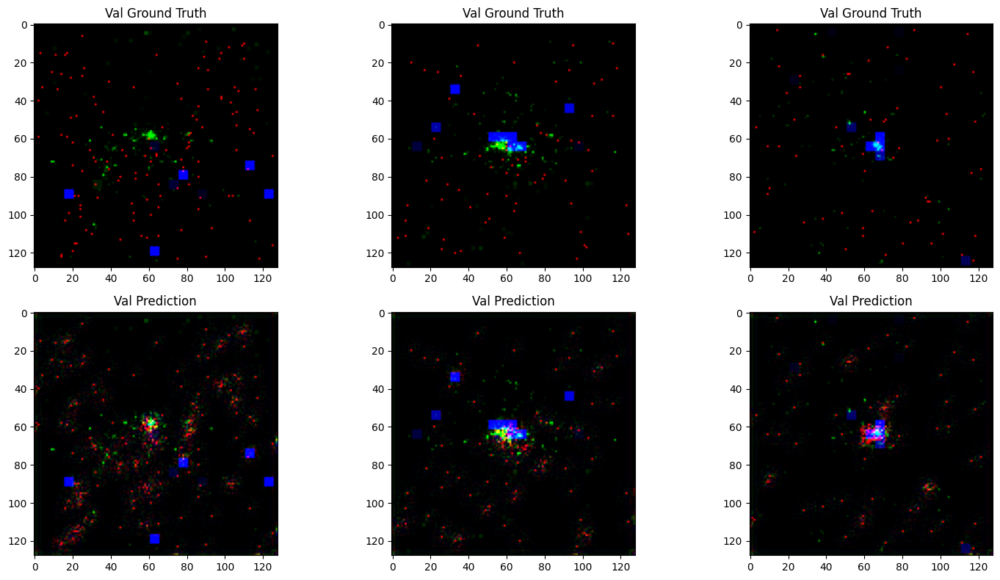

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 980ms/step - accuracy: 0.2820 - loss: 3.3197e-07 - mse: 1.3770e-08 - val_accuracy: 0.1232 - val_loss: 2.8565e-07 - val_mse: 1.1919e-08
Epoch 67/100
43/79 ━━━━━━━━━━━━━━━━━━━━ 34s 950ms/step - accuracy: 0.4020 - loss: 2.1838e-07 - mse: 1.1158e-08

KeyboardInterrupt: 

In [23]:
visual_callback = VisualizePredictionCallback(train_data=(traindata, traindata), 
                                              val_data=(validdata, validdata), 
                                              num_samples=3)

model.compile(loss=sparse_weighted_loss, optimizer=optim.Adam(learning_rate=1e-4), metrics=["accuracy", "mse" ])
history = model.fit(traindata, traindata, epochs=100, verbose=1, batch_size=64, validation_data=[validdata, validdata], 
                    validation_batch_size=64, callbacks=[visual_callback])


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - accuracy: 0.4140 - loss: 1.4865e-07 - mse: 7.4142e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..161.03761].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8694739..161.85979].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..149.41388].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9170817..149.37645].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..124.663666].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.61117..124.30672].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..127.40065].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0897101..128.0583].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..120.65823].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.924894..123.63023].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..171.61497].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6415141..172.12556].


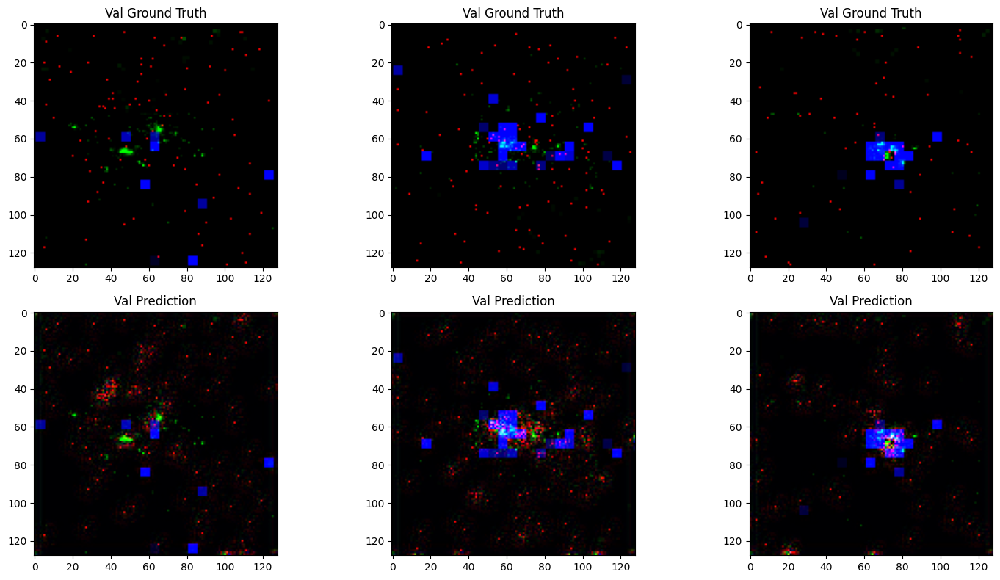

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 972ms/step - accuracy: 0.4142 - loss: 1.4870e-07 - mse: 7.4163e-09 - val_accuracy: 0.2690 - val_loss: 2.3274e-07 - val_mse: 9.0105e-09
Epoch 46/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3925 - loss: 1.5158e-07 - mse: 7.4595e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..131.0651].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.188873..128.96802].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..110.6658].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8420335..111.325676].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..127.53005].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.958749..127.74511].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..164.48553].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.068221..162.38191].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..134.36066].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5992506..134.95746].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..109.94313].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8596687..108.954834].


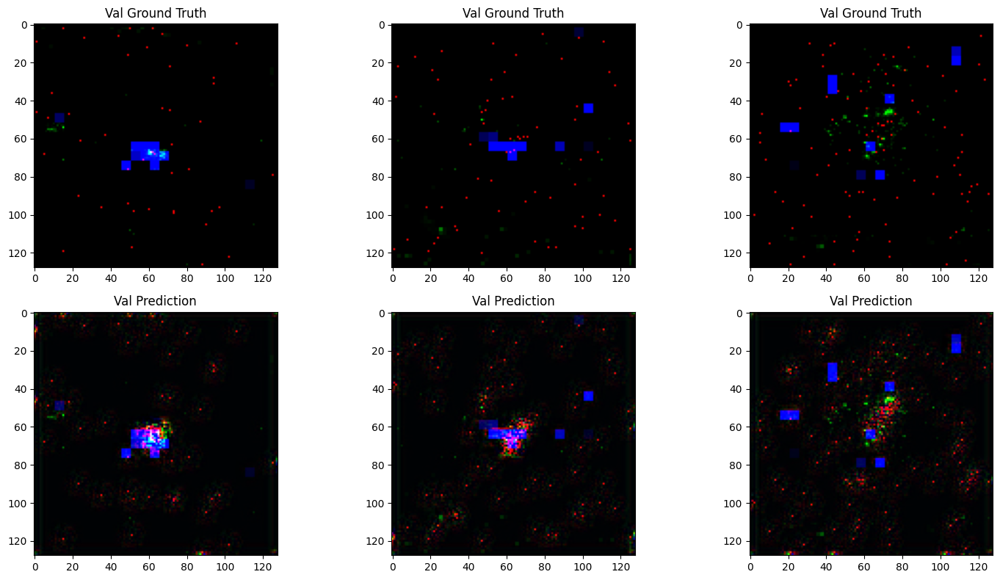

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 970ms/step - accuracy: 0.3927 - loss: 1.5158e-07 - mse: 7.4604e-09 - val_accuracy: 0.2397 - val_loss: 2.4046e-07 - val_mse: 8.9841e-09
Epoch 47/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/steptep - accuracy: 0.4050 - loss: 1.5456e-07 - mse: 7.8703e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..115.33548].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6697721..114.608765].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..150.72533].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.6705701..152.88333].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..114.856316].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.031619..114.60459].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..168.86876].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0493495..167.3343].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..144.25581].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.5733447..144.28313].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..138.88924].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.2237754..139.4305].


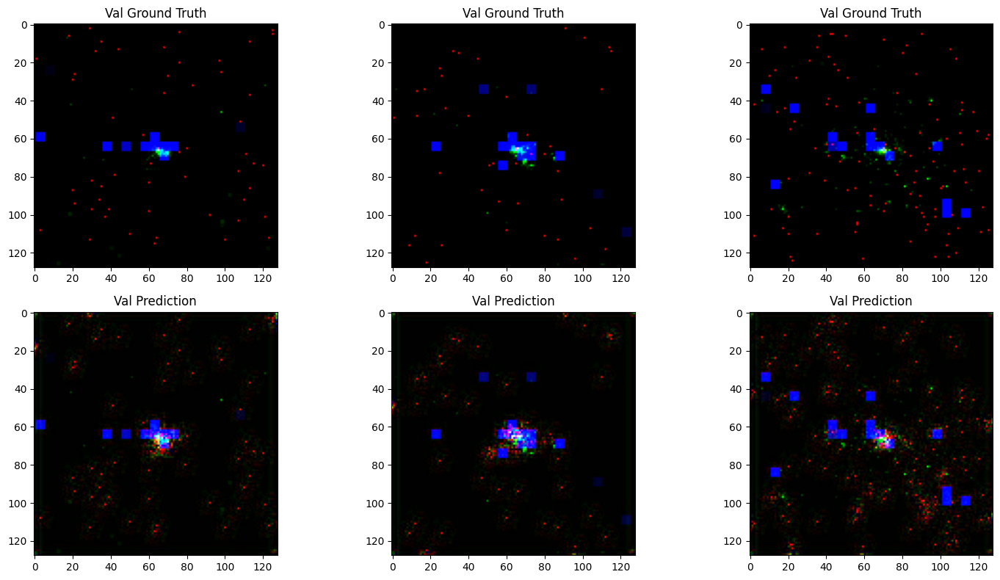

79/79 ━━━━━━━━━━━━━━━━━━━━ 75s 952ms/step - accuracy: 0.4053 - loss: 1.5452e-07 - mse: 7.8663e-09 - val_accuracy: 0.2743 - val_loss: 2.3021e-07 - val_mse: 8.8128e-09
Epoch 48/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.4221 - loss: 1.5124e-07 - mse: 7.5168e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..121.59087].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0635915..120.673004].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..116.45526].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7755508..115.901375].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..160.97229].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.6357155..159.10138].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..121.164116].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0161961..121.29787].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..143.13725].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.7812378..141.58661].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..183.21451].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.9212413..187.14159].


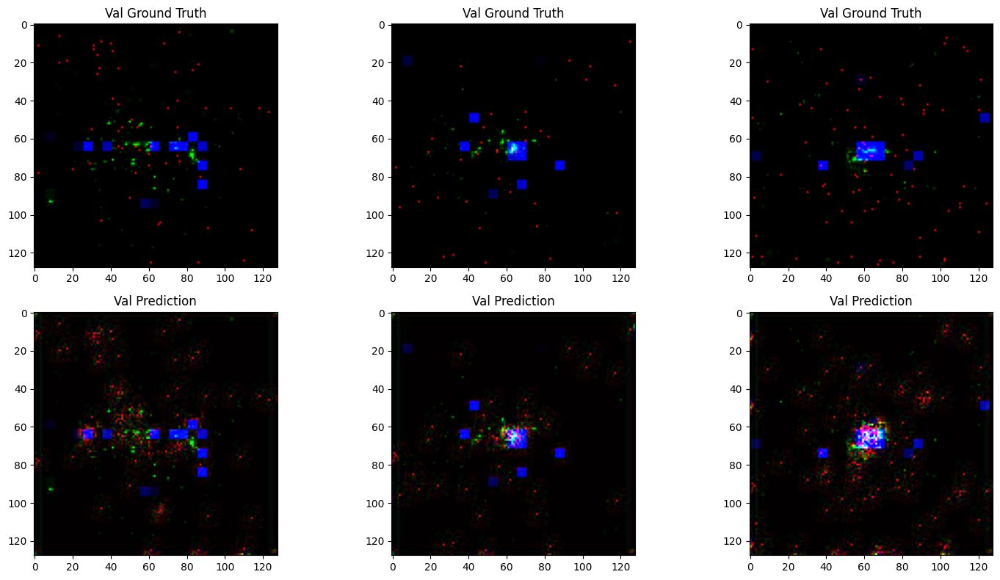

79/79 ━━━━━━━━━━━━━━━━━━━━ 81s 1s/step - accuracy: 0.4222 - loss: 1.5123e-07 - mse: 7.5162e-09 - val_accuracy: 0.5731 - val_loss: 2.3011e-07 - val_mse: 8.8154e-09
Epoch 49/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.4116 - loss: 1.4853e-07 - mse: 7.3346e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..135.16757].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7372355..135.48093].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..144.61623].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.890022..143.5174].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..162.03255].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.077679..163.37483].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..136.64719].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.678459..138.15578].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..130.94136].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3671508..133.37177].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..150.27399].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.5112638..150.24272].


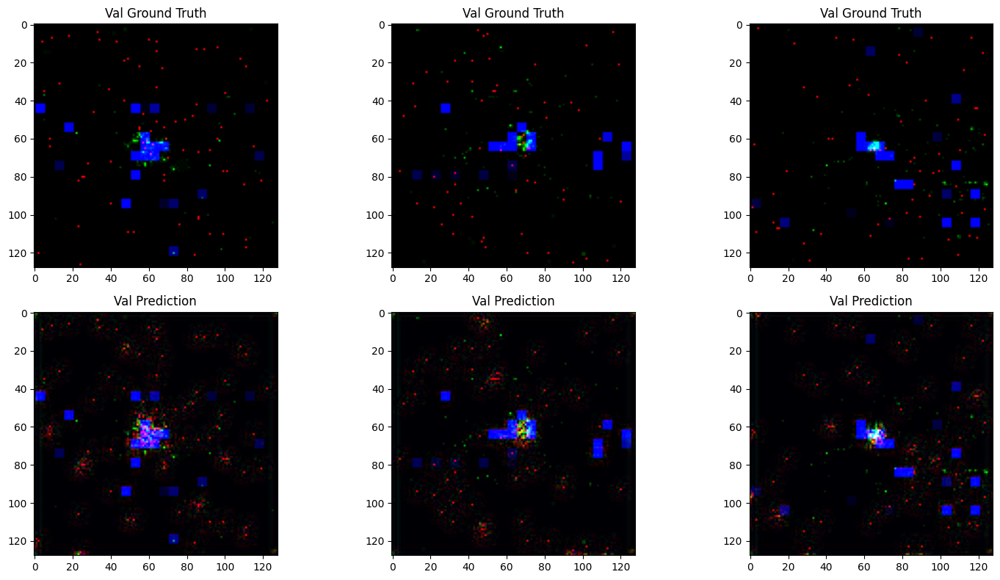

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 961ms/step - accuracy: 0.4116 - loss: 1.4856e-07 - mse: 7.3364e-09 - val_accuracy: 0.2332 - val_loss: 2.3338e-07 - val_mse: 8.8688e-09
Epoch 50/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.3763 - loss: 1.5531e-07 - mse: 7.5146e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..150.67656].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.223381..150.43721].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..132.89441].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3937383..131.45706].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..170.15346].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0916862..168.75006].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..150.18088].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.2879305..149.41829].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..111.283226].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3200839..111.942535].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..135.35776].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1036913..135.73308].


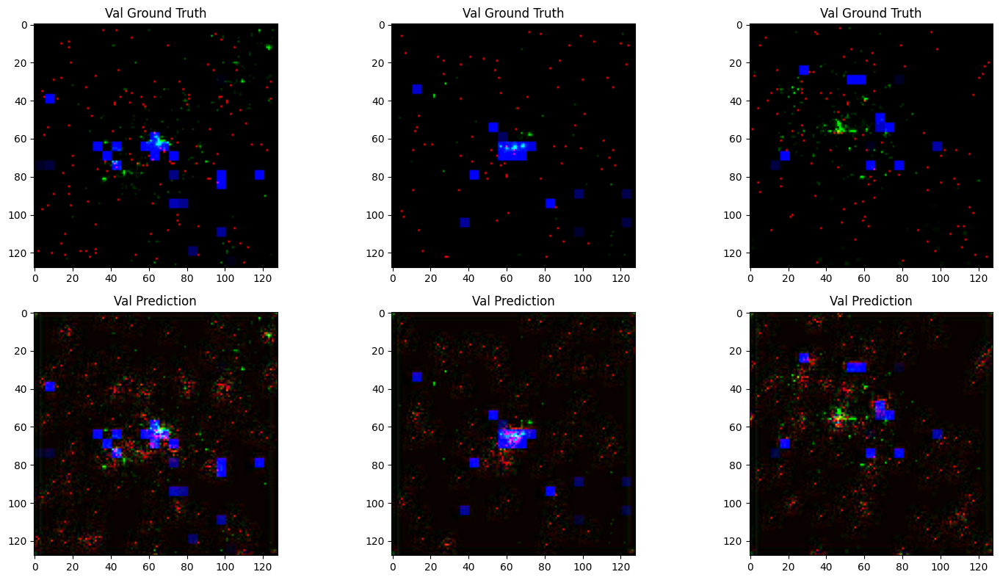

79/79 ━━━━━━━━━━━━━━━━━━━━ 76s 969ms/step - accuracy: 0.3766 - loss: 1.5528e-07 - mse: 7.5146e-09 - val_accuracy: 0.7427 - val_loss: 2.2809e-07 - val_mse: 9.1526e-09
Epoch 51/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.4426 - loss: 1.4607e-07 - mse: 7.3641e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..129.24141].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.4580817..126.89677].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..234.78333].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.7159638..234.55702].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..134.3259].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.5379267..134.8893].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..155.61018].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.13278..152.81612].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..120.84968].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.8639498..120.55174].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..118.82753].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1312828..118.36002].


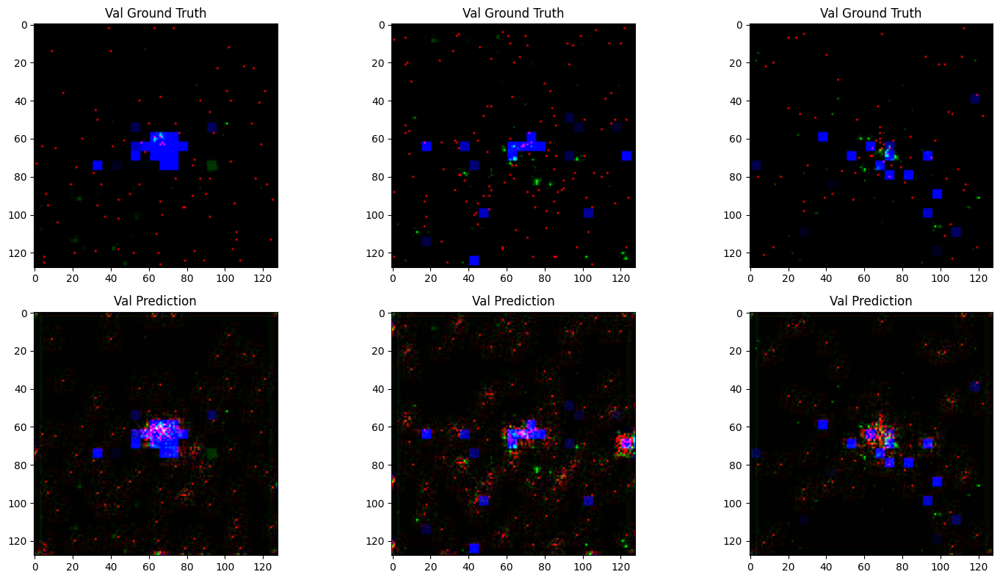

79/79 ━━━━━━━━━━━━━━━━━━━━ 77s 984ms/step - accuracy: 0.4424 - loss: 1.4611e-07 - mse: 7.3649e-09 - val_accuracy: 0.3687 - val_loss: 2.2838e-07 - val_mse: 8.6879e-09
Epoch 52/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - accuracy: 0.4176 - loss: 1.4683e-07 - mse: 7.2354e-0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..129.92574].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7102535..130.83908].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..148.61472].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9920412..147.19894].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..102.081635].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4924644..102.16357].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..119.62599].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.046296..119.08418].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..135.74602].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.768088..135.48528].


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..117.895676].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3558649..117.91155].


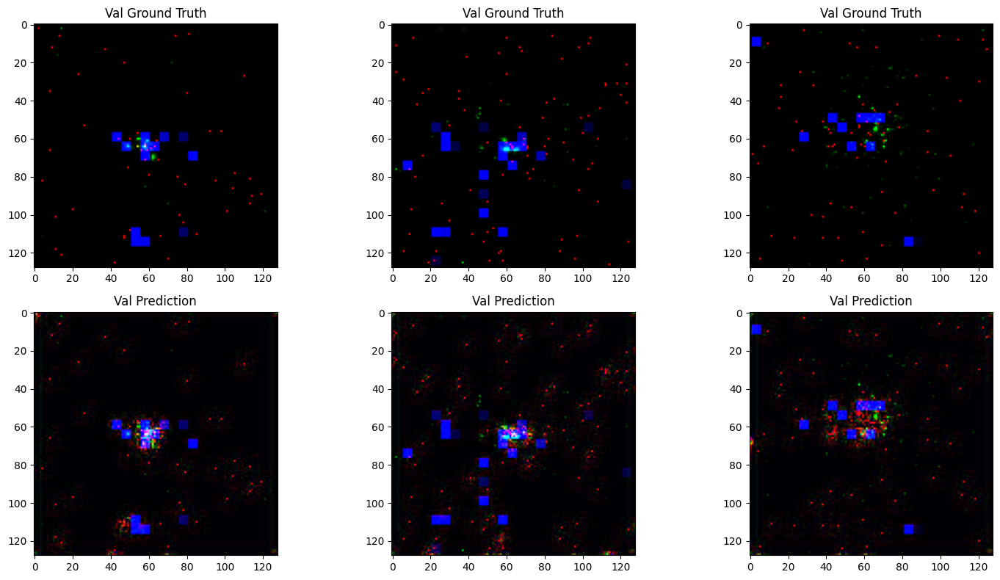

79/79 ━━━━━━━━━━━━━━━━━━━━ 75s 957ms/step - accuracy: 0.4176 - loss: 1.4686e-07 - mse: 7.2374e-09 - val_accuracy: 0.2661 - val_loss: 2.4187e-07 - val_mse: 8.8678e-09
Epoch 53/100
59/79 ━━━━━━━━━━━━━━━━━━━━ 18s 939ms/step - accuracy: 0.3837 - loss: 1.5429e-07 - mse: 7.5123e-09

KeyboardInterrupt: 

In [24]:
visual_callback = VisualizePredictionCallback(train_data=(traindata, traindata), 
                                              val_data=(validdata, validdata), 
                                              num_samples=3)

model.compile(loss=sparse_weighted_loss, optimizer=optim.Adam(learning_rate=1e-5), metrics=["accuracy", "mse" ])
history = model.fit(traindata, traindata, epochs=100, verbose=1, batch_size=64, validation_data=[validdata, validdata], 
                    validation_batch_size=64, callbacks=[visual_callback])
